#### This Python 3 environment comes with many helpful analytics libraries installed
# It is defined by the kaggle/python Docker image: https://github.com/kaggle/docker-python
# For example, here's several helpful packages to load

import numpy as np # linear algebra
import pandas as pd # data processing, CSV file I/O (e.g. pd.read_csv)

# Input data files are available in the read-only "../input/" directory
# For example, running this (by clicking run or pressing Shift+Enter) will list all files under the input directory

import os
for dirname, _, filenames in os.walk('/kaggle/input'):
    for filename in filenames:
        print(os.path.join(dirname, filename))

# You can write up to 20GB to the current directory (/kaggle/working/) that gets preserved as output when you create a version using "Save & Run All" 
# You can also write temporary files to /kaggle/temp/, but they won't be saved outside of the current session

In [ ]:
!pip install torch torchvision torchaudio --extra-index-url https://download.pytorch.org/whl/cu118  # Adjust CUDA version if needed
!pip install librosa numpy pandas soundfile


In [7]:
import os
import torch
from torch.utils.data import Dataset, DataLoader
import torchaudio
import pandas as pd

os.environ["TOKENIZERS_PARALLELISM"] = "false"


In [8]:
from transformers import AutoProcessor, AutoModel

# Device configuration
device = torch.device('cuda' if torch.cuda.is_available() else 'cpu')

# Load pre-trained CLIP model and tokenizer
clap_processor = AutoProcessor.from_pretrained("laion/clap-htsat-unfused")
clap_model = AutoModel.from_pretrained("laion/clap-htsat-unfused").eval().to(device)

def get_clip_embedding(prompt):
    inputs = clap_processor(prompt, return_tensors="pt").to(device)  # Ensure it returns tensors
    with torch.no_grad():
        outputs = clap_model.get_text_features(**inputs)  # Get the text embeddings
    return outputs


/opt/conda/lib/python3.10/site-packages/transformers/tokenization_utils_base.py:1601: FutureWarning: `clean_up_tokenization_spaces` was not set. It will be set to `True` by default. This behavior will be depracted in transformers v4.45, and will be then set to `False` by default. For more details check this issue: https://github.com/huggingface/transformers/issues/31884
  warnings.warn(


### new one

In [3]:
!pip install torch torchvision torchaudio transformers diffusers datasets


In [9]:
import os
import pandas as pd
import numpy as np

In [10]:
# Define the Loss Prompt Generators
instrument_code_to_name = {
1: "Acoustic Grand Piano",
2: "Bright Acoustic Piano",
3: "Electric Grand Piano",
4: "Honky-tonk Piano",
5: "Electric Piano 1",
6: "Electric Piano 2",
7: "Harpsichord",
8: "Clavi",
9: "Celesta",
10: "Glockenspiel",
11: "Music Box",
12: "Vibraphone",
13: "Marimba",
14: "Xylophone",
15: "Tubular Bells",
16: "Dulcimer",
17: "Drawbar Organ",
18: "Percussive Organ",
19: "Rock Organ",
20: "Church Organ",
21: "Reed Organ",
22: "Accordion",
23: "Harmonica",
24: "Tango Accordion",
25: "Acoustic Guitar (nylon)",
26: "Acoustic Guitar (steel)",
27: "Electric Guitar (jazz)",
28: "Electric Guitar (clean)",
29: "Electric Guitar (muted)",
30: "Overdriven Guitar",
31: "Distortion Guitar",
32: "Guitar harmonics",
33: "Acoustic Bass",
34: "Electric Bass (finger)",
35: "Electric Bass (pick)",
36: "Fretless Bass",
37: "Slap Bass 1",
38: "Slap Bass 2",
39: "Synth Bass 1",
40: "Synth Bass 2",
41: "Violin",
42: "Viola",
43: "Cello",
44: "Contrabass",
45: "Tremolo Strings",
46: "Pizzicato Strings",
47: "Orchestral Harp",
48: "Timpani",
49: "String Ensemble 1",
50: "String Ensemble 2",
51: "SynthStrings 1",
52: "SynthStrings 2",
53: "Choir Aahs",
54: "Voice Oohs",
55: "Synth Voice",
56: "Orchestra Hit",
57: "Trumpet",
58: "Trombone",
59: "Tuba",
60: "Muted Trumpet",
61: "French Horn",
62: "Brass Section",
63: "SynthBrass 1",
64: "SynthBrass 2",
65: "Soprano Sax",
66: "Alto Sax",
67: "Tenor Sax",
68: "Baritone Sax",
69: "Oboe",
70: "English Horn",
71: "Bassoon",
72: "Clarinet",
73: "Piccolo",
74: "Flute",
75: "Recorder",
76: "Pan Flute",
77: "Blown Bottle",
78: "Shakuhachi",
79: "Whistle",
80: "Ocarina",
81: "Lead 1 (square)",
82: "Lead 2 (sawtooth)",
83: "Lead 3 (calliope)",
84: "Lead 4 (chiff)",
85: "Lead 5 (charang)",
86: "Lead 6 (voice)",
87: "Lead 7 (fifths)",
88: "Lead 8 (bass + lead)",
89: "Pad 1 (new age)",
90: "Pad 2 (warm)",
91: "Pad 3 (polysynth)",
92: "Pad 4 (choir)",
93: "Pad 5 (bowed)",
94: "Pad 6 (metallic)",
95: "Pad 7 (halo)",
96: "Pad 8 (sweep)",
97: "FX 1 (rain)",
98: "FX 2 (soundtrack)",
99: "FX 3 (crystal)",
100: "FX 4 (atmosphere)",
101: "FX 5 (brightness)",
102: "FX 6 (goblins)",
103: "FX 7 (echoes)",
104: "FX 8 (sci-fi)",
105: "Sitar",
106: "Banjo",
107: "Shamisen",
108: "Koto",
109: "Kalimba",
110: "Bag pipe",
111: "Fiddle",
112: "Shanai",
113: "Tinkle Bell",
114: "Agogo",
115: "Steel Drums",
116: "Woodblock",
117: "Taiko Drum",
118: "Melodic Tom",
119: "Synth Drum",
120: "Reverse Cymbal",
121: "Guitar Fret Noise",
122: "Breath Noise",
123: "Seashore",
124: "Bird Tweet",
125: "Telephone Ring",
126: "Helicopter",
127: "Applause",
128: "Gunshot"
}


In [11]:
note_value_encoded_to_name = {
    0: 'Sixteenth',
    1: 'Dotted Half',
    2: 'Half',
    3: 'Dotted Quarter',
    4: 'Dotted Eighth',
    5: 'Quarter',
    6: 'Eighth',
    # Add other mappings as needed
}


In [12]:
def generate_note_prompt(note_meta):
    instrument_code = note_meta.get('instrument', 'Unknown')
    instrument_name = instrument_code_to_name.get(instrument_code, 'Unknown Instrument')
    note_value_encoded = note_meta.get('note_value_encoded', None)
    note_value = note_value_encoded_to_name.get(note_value_encoded, 'Unknown') if note_value_encoded is not None else 'Unknown'
    note_number = note_meta.get('note', 'Unknown')
    prompt = f"A {note_value.lower()} note (MIDI note {note_number}) played by {instrument_name}"
    return prompt

def generate_composition_prompt(composition_meta):
    composer = composition_meta.get('composer', 'Unknown Composer')
    composition = composition_meta.get('composition', 'Unknown Composition')
    movement = composition_meta.get('movement', 'Unknown Movement')
    ensemble = composition_meta.get('ensemble', 'Unknown Ensemble')
    prompt = f"An excerpt from {composer}'s {composition}, {movement}, performed by a {ensemble}"
    return prompt


In [13]:
# Replace with your actual paths
note_meta_dir = '/kaggle/input/musicnet-dataset/musicnet/musicnet/train_labels'
composition_meta_file = '/kaggle/input/musicnet-dataset/musicnet_metadata.csv'
audio_directory = '/kaggle/input/musicnet-dataset/musicnet/musicnet/train_data'


In [14]:
# Load composition metadata into a DataFrame
df_composition = pd.read_csv(composition_meta_file)

# Create a dictionary mapping audio IDs to composition metadata
composition_metadata_dict = df_composition.set_index('id').to_dict('index')


In [15]:
# List all note metadata CSV files
note_meta_files = sorted([f for f in os.listdir(note_meta_dir) if f.endswith('.csv')])

# Map each audio ID to its note metadata file path
note_metadata_files = {}
for file in note_meta_files:
    # Extract audio ID from filename, assuming the filename is like '1727.csv'
    audio_id = int(file.split('.')[0])  # Get '1727' and convert to int
    file_path = os.path.join(note_meta_dir, file)
    note_metadata_files[audio_id] = file_path

# Load note metadata for each audio ID
note_metadata_dict = {}
for audio_id, file_path in note_metadata_files.items():
    df_note = pd.read_csv(file_path)
    # Convert DataFrame to list of dictionaries
    note_meta_records = df_note.to_dict('records')  # Renamed variable to avoid conflicts
    note_metadata_dict[audio_id] = note_meta_records


In [16]:
# List all audio files
audio_files = sorted([f for f in os.listdir(audio_directory) if f.endswith('.wav')])

# Map each audio file to its audio ID
audio_id_to_path = {}
for file in audio_files:
    # Extract audio ID from filename, assuming the filename is like '1727.wav'
    audio_id = int(file.split('.')[0])  # Get '1727' and convert to int
    audio_path = os.path.join(audio_directory, file)
    audio_id_to_path[audio_id] = audio_path


In [17]:
# Load composition metadata
df_composition = pd.read_csv(composition_meta_file)

# Load note metadata and combine with composition metadata
data = []

# Iterate over each audio ID
for audio_id in audio_id_to_path:
    # Get composition metadata
    composition_meta = composition_metadata_dict.get(audio_id, {})
    composition_prompt = generate_composition_prompt(composition_meta)
    
    # Get note metadata
    note_meta_list = note_metadata_dict.get(audio_id, [])
    
    # Get the audio file path
    audio_path = audio_id_to_path[audio_id]
    
    # For each note, generate a note prompt and collect the data
    for note_meta in note_meta_list:
        note_prompt = generate_note_prompt(note_meta)
        
        # Combine prompts
        full_prompt = f"{composition_prompt}. {note_prompt}."
        
        # Append to the data list
        data.append({
            'audio_id': audio_id,
            'audio_path': audio_path,
            'composition_prompt': composition_prompt,
            'note_prompt': note_prompt,
            'full_prompt': full_prompt,
            'note_meta': note_meta
        })

# Convert to DataFrame
df_data = pd.DataFrame(data)

# Remove duplicates if necessary
df_data.drop_duplicates(subset=['audio_id', 'full_prompt'], inplace=True)


In [18]:
# Save DataFrame to CSV
df_data.to_csv('musicnet_prompts.csv', index=False)

In [19]:
import torch
import pandas as pd
from transformers import AutoProcessor, AutoModel

# Check if GPU is available
device = torch.device('cuda' if torch.cuda.is_available() else 'cpu')

# Load CLAP processor and model
clap_processor = AutoProcessor.from_pretrained("laion/clap-htsat-unfused")
clap_model = AutoModel.from_pretrained("laion/clap-htsat-unfused").eval().to(device)

# Load your dataset (assuming it has a column 'full_prompt')
df_full_data = pd.read_csv('/kaggle/working/musicnet_prompts.csv')

# Function to precompute CLAP embeddings
def precompute_text_embeddings(prompt):
    # Tokenize the input text
    inputs = clap_processor(
        text=prompt,
        return_tensors="pt",
        padding=True,
        truncation=True
    ).to(device)
    
    # Compute embeddings using the CLAP model
    with torch.no_grad():
        text_embedding = clap_model.get_text_features(**inputs)
    
    # Move embedding to CPU and convert to numpy
    return text_embedding.squeeze(0).cpu().numpy()

# Apply the function to the dataset to precompute embeddings
df_full_data['precomputed_embedding'] = df_full_data['full_prompt'].apply(precompute_text_embeddings)

# Save the dataset with precomputed embeddings as a PyTorch file
torch.save(df_full_data, 'musicnet_with_precomputed_embeddings.pt')

print("Precomputed embeddings saved successfully!")


/opt/conda/lib/python3.10/site-packages/transformers/tokenization_utils_base.py:1601: FutureWarning: `clean_up_tokenization_spaces` was not set. It will be set to `True` by default. This behavior will be depracted in transformers v4.45, and will be then set to `False` by default. For more details check this issue: https://github.com/huggingface/transformers/issues/31884
  warnings.warn(


Precomputed embeddings saved successfully!


In [20]:
import torch
import pandas as pd
from sklearn.model_selection import train_test_split

# Load the precomputed dataset
df_with_embeddings = torch.load('musicnet_with_precomputed_embeddings.pt')

# If the saved file is a PyTorch tensor and the original dataset was in a DataFrame-like format,
# Convert it back to a pandas DataFrame if necessary:
df_with_embeddings = pd.DataFrame(df_with_embeddings)


/tmp/ipykernel_588/3924498482.py:6: FutureWarning: You are using `torch.load` with `weights_only=False` (the current default value), which uses the default pickle module implicitly. It is possible to construct malicious pickle data which will execute arbitrary code during unpickling (See https://github.com/pytorch/pytorch/blob/main/SECURITY.md#untrusted-models for more details). In a future release, the default value for `weights_only` will be flipped to `True`. This limits the functions that could be executed during unpickling. Arbitrary objects will no longer be allowed to be loaded via this mode unless they are explicitly allowlisted by the user via `torch.serialization.add_safe_globals`. We recommend you start setting `weights_only=True` for any use case where you don't have full control of the loaded file. Please open an issue on GitHub for any issues related to this experimental feature.
  df_with_embeddings = torch.load('musicnet_with_precomputed_embeddings.pt')


In [21]:
# Split the data into train and test sets using sklearn's train_test_split
df_train_data, df_test_data = train_test_split(df_with_embeddings, test_size=0.2, random_state=42)


In [22]:
df_train_data.head()

,audio_id,audio_path,composition_prompt,note_prompt,full_prompt,note_meta,precomputed_embedding
13922,2322,/kaggle/input/musicnet-dataset/musicnet/musicn...,An excerpt from Beethoven's Piano Sonata No 23...,A unknown note (MIDI note 71) played by Acoust...,An excerpt from Beethoven's Piano Sonata No 23...,"{'start_time': 1298910, 'end_time': 1366494, '...","[0.0062358575, -0.019757006, -0.057421416, 0.0..."
21003,2528,/kaggle/input/musicnet-dataset/musicnet/musicn...,An excerpt from Beethoven's Piano Sonata No 5 ...,A unknown note (MIDI note 52) played by Acoust...,An excerpt from Beethoven's Piano Sonata No 5 ...,"{'start_time': 11663326, 'end_time': 11671006,...","[0.008363217, -0.03843644, -0.05358563, 0.0226..."
23661,2619,/kaggle/input/musicnet-dataset/musicnet/musicn...,An excerpt from Beethoven's Piano Sonata No 6 ...,A unknown note (MIDI note 39) played by Acoust...,An excerpt from Beethoven's Piano Sonata No 6 ...,"{'start_time': 410590, 'end_time': 428510, 'in...","[-0.0002505928, -0.032857925, -0.055814616, 0...."
7821,2140,/kaggle/input/musicnet-dataset/musicnet/musicn...,An excerpt from Brahms's String Quartet in C m...,A unknown note (MIDI note 78) played by Viola,An excerpt from Brahms's String Quartet in C m...,"{'start_time': 12306909, 'end_time': 12344286,...","[0.050977457, 0.006929969, -0.015130859, -0.05..."
11100,2204,/kaggle/input/musicnet-dataset/musicnet/musicn...,"An excerpt from Bach's Partita in A minor, 3. ...",A unknown note (MIDI note 82) played by Flute,"An excerpt from Bach's Partita in A minor, 3. ...","{'start_time': 2419166, 'end_time': 2431966, '...","[0.045603655, -0.01808068, 0.04921948, -0.0118..."


In [31]:
# import torch
# import torchaudio
# import numpy as np
# from scipy.signal import butter, sosfilt

# class CustomAudioDataset(torch.utils.data.Dataset):
#     def __init__(self, audio_paths, note_metadata_list, composition_metadata_list, transform=None, fixed_length=110250):
#         self.audio_paths = audio_paths
#         self.note_metadata_list = note_metadata_list
#         self.composition_metadata_list = composition_metadata_list
#         self.transform = transform
#         self.fixed_length = fixed_length  # Fixed length in samples

#         # Define the MelSpectrogram transform
#         self.mel_spectrogram_transform = torchaudio.transforms.MelSpectrogram(
#             sample_rate=22050,
#             n_fft=1024,
#             n_mels=128
#         )

#     def __len__(self):
#         return len(self.audio_paths)

#     def __getitem__(self, idx):
#         # Load audio
#         audio_path = self.audio_paths[idx]
#         waveform, sample_rate = torchaudio.load(audio_path)
#         # Resample if necessary
#         target_sample_rate = 22050
#         if sample_rate != target_sample_rate:
#             resampler = torchaudio.transforms.Resample(
#                 orig_freq=sample_rate, new_freq=target_sample_rate)
#             waveform = resampler(waveform)

#         # Preprocessing steps
#         # 1. Convert to mono if necessary
#         if waveform.shape[0] > 1:
#             waveform = torch.mean(waveform, dim=0, keepdim=True)

#         # 2. Amplitude Normalization
#         waveform = self.normalize_amplitude(waveform)

#         # 3. Silence Removal
#         waveform = self.remove_silence(waveform, target_sample_rate)

#         # 4. High-Pass Filter (Optional)
#         waveform = self.apply_high_pass_filter(waveform, target_sample_rate)

#         # 5. Pad or Trim waveform to fixed length
#         waveform = self.pad_or_trim(waveform, self.fixed_length)
        
#         # **Convert waveform to FloatTensor (float32)**
#         waveform = waveform.float()  # Explicitly cast to float32
        
#         # Apply Mel-Spectrogram transform
#         mel_spectrogram = self.mel_spectrogram_transform(waveform)
        
#             # Remove the extra channel dimension
#         mel_spectrogram = mel_spectrogram.squeeze(0)  # [128, Time]

#         # **Convert to FloatTensor (float32)**
#         mel_spectrogram = mel_spectrogram.float()

# #          Generate metadata prompts
#         note_meta_list = self.note_metadata_list[idx]
#         note_meta = note_meta_list[0] if note_meta_list else {'instrument': 'Unknown', 'note_value_encoded': None, 'note': 'Unknown'}

#         composition_meta = self.composition_metadata_list[idx]

#         # Generate prompts
#         note_prompt = generate_note_prompt(note_meta)
#         composition_prompt = generate_composition_prompt(composition_meta)

#         text_prompt = f"{note_prompt}. {composition_prompt}."

#         return mel_spectrogram, text_prompt

#     def normalize_amplitude(self, waveform):
#         max_amplitude = waveform.abs().max()
#         if max_amplitude > 0:
#             waveform = waveform / max_amplitude
#         return waveform

#     def remove_silence(self, waveform, sample_rate, threshold=0.01):
#         # Compute the amplitude envelope with a moving window
#         amplitude_envelope = waveform.abs()
#         # Identify frames where the amplitude is above the threshold
#         mask = amplitude_envelope > threshold
#         if mask.any():
#             indices = mask.nonzero()
#             start = indices[0, 1]
#             end = indices[-1, 1]
#             waveform = waveform[:, start:end+1]
#         else:
#             # If the entire waveform is below the threshold, return it as is
#             pass
#         return waveform

#     def apply_high_pass_filter(self, waveform, sample_rate, cutoff_freq=80):
#         sos = butter(10, cutoff_freq, btype='highpass', fs=sample_rate, output='sos')
#         filtered_waveform = sosfilt(sos, waveform.numpy(), axis=1)
#         return torch.from_numpy(filtered_waveform)

#     def pad_or_trim(self, waveform, fixed_length):
#         current_length = waveform.shape[1]
#         n_fft = self.mel_spectrogram_transform.n_fft  # Get n_fft size

#         # Ensure waveform is at least n_fft long for STFT
#         if current_length < n_fft:
#             pad_amount = n_fft - current_length
#             waveform = torch.nn.functional.pad(waveform, (0, pad_amount))

#         # Pad to fixed length
#         if current_length < fixed_length:
#             pad_amount = fixed_length - current_length
#             waveform = torch.nn.functional.pad(waveform, (0, pad_amount))
#         elif current_length > fixed_length:
#             # Trim the waveform if longer than fixed length
#             waveform = waveform[:, :fixed_length]

#         # Ensure waveform is FloatTensor
#         waveform = waveform.float()

#         return waveform






In [27]:
import torch
import torchaudio

class MusicNetDataset(torch.utils.data.Dataset):
    def __init__(self, df_data, sr=16000, duration=10.0, n_mels=1024, hop_length=512, n_fft=2048):
        self.df_data = df_data.reset_index(drop=True)
        self.sr = sr
        self.duration = duration
        self.fixed_length = int(sr * duration)
        self.n_mels = n_mels
        self.hop_length = hop_length
        self.n_fft = n_fft
        # Initialize the mel-spectrogram transform
        self.mel_spectrogram_transform = transforms.MelSpectrogram(
            sample_rate=sr, 
            n_fft=n_fft, 
            hop_length=hop_length, 
            n_mels=n_mels
        )

        # Precompute the list of all chunks
        self.audio_chunks = []
        for idx in range(len(self.df_data)):
            audio_path = self.df_data.iloc[idx]['audio_path']
            # Use torchaudio.info to get the number of frames (samples)
            try:
                metadata = torchaudio.info(audio_path)
                num_frames = metadata.num_frames
            except RuntimeError:
                print(f"Error reading {audio_path}")
                continue
            num_chunks = (num_frames + self.fixed_length - 1) // self.fixed_length
            for chunk_idx in range(num_chunks):
                self.audio_chunks.append((idx, chunk_idx))

    def __len__(self):
        return len(self.audio_chunks)

    def __getitem__(self, idx):
        # Get the audio file index and chunk index
        audio_file_idx, chunk_idx = self.audio_chunks[idx]

        # Load audio and prompt data
        audio_path = self.df_data.iloc[audio_file_idx]['audio_path']
        prompt_embedding = self.df_data.iloc[audio_file_idx]['precomputed_embedding']

        # Load and preprocess audio using torchaudio
        y, sr = torchaudio.load(audio_path)

        # Resample if necessary
        if sr != self.sr:
            resampler = torchaudio.transforms.Resample(orig_freq=sr, new_freq=self.sr)
            y = resampler(y)

        # Convert stereo to mono if necessary
        if y.shape[0] > 1:
            y = y.mean(dim=0)

        # Get the start and end indices for this chunk (10-second segment)
        start_idx = chunk_idx * self.fixed_length
        end_idx = start_idx + self.fixed_length

        # Extract the chunk of audio, padding with zeros if the last chunk is shorter
        audio_chunk = y[..., start_idx:end_idx]
        if audio_chunk.shape[-1] < self.fixed_length:
            padding = self.fixed_length - audio_chunk.shape[-1]
            audio_chunk = torch.nn.functional.pad(audio_chunk, (0, padding))

        # Ensure audio_chunk is 1D [Time]
        if audio_chunk.dim() > 1:
            audio_chunk = audio_chunk.squeeze(0)
        
        # Compute the mel-spectrogram
        log_mel_spec = self.mel_spectrogram_transform(audio_chunk)

        # Convert Mel-spectrogram to a tensor
        mel_spec_tensor = torch.log(log_mel_spec + 1e-6)  # [n_mels, time_steps]

        # Handle prompt embedding
        if isinstance(prompt_embedding, torch.Tensor):
            prompt_embedding_tensor = prompt_embedding.clone().detach().float()
        else:
            prompt_embedding_tensor = torch.from_numpy(prompt_embedding).clone().detach().float()

        # Ensure the tensor is 1D [embedding_dim]
        prompt_embedding_tensor = prompt_embedding_tensor.squeeze()

        # Verify the shape
        assert prompt_embedding_tensor.dim() == 1, f"Expected 1D tensor, got {prompt_embedding_tensor.dim()}D"

        return {
            'mel_spec': mel_spec_tensor,                 # [n_mels, time_steps]
            'prompt_embedding': prompt_embedding_tensor   # [embedding_dim]
        }



In [ ]:
import torchaudio.transforms as transforms

# Define batch size
BATCH_SIZE = 16  # Adjust based on your GPU memory

# Create the train and test datasets
train_dataset = MusicNetDataset(df_data=df_train_data)
test_dataset = MusicNetDataset(df_data=df_test_data)

# import torch.nn.functional as F

# def custom_collate_fn(batch):
#     batch_dict = {}

#     # Find the maximum time steps for padding
#     max_time_steps = max(item['mel_spec'].shape[1] for item in batch)

#     # Pad all mel-spectrograms to the same time dimension (max_time_steps)
#     mel_specs_padded = [
#         F.pad(item['mel_spec'], (0, max_time_steps - item['mel_spec'].shape[1]), "constant", 0) 
#         for item in batch
#     ]

#     # Stack the mel-spectrograms and prompt embeddings along the batch dimension
#     batch_dict['mel_spec'] = torch.stack(mel_specs_padded, dim=0)  # [batch_size, n_mels, max_time_steps]
#     batch_dict['prompt_embedding'] = torch.stack([item['prompt_embedding'] for item in batch], dim=0)

#     return batch_dict


train_loader = DataLoader(train_dataset, batch_size=BATCH_SIZE, shuffle=True, num_workers=4, collate_fn=custom_collate_fn)
test_loader = DataLoader(test_dataset, batch_size=BATCH_SIZE, shuffle=False, num_workers=4,collate_fn=custom_collate_fn)




KeyboardInterrupt: 

In [ ]:
len(train_loader)

In [78]:
import torch
import torch.nn as nn
import torchaudio

# Check if CUDA is available and define the device
device = torch.device("cuda" if torch.cuda.is_available() else "cpu")

# Define the Audio Encoder model with more layers and complexity
class AudioEncoder(nn.Module):
    def __init__(self, input_channels=1, latent_dim=256):
        super(AudioEncoder, self).__init__()
        self.encoder = nn.Sequential(
            nn.Conv2d(input_channels, 64, kernel_size=3, padding=1),
            nn.ReLU(),
            nn.MaxPool2d(2),
            nn.Conv2d(64, 128, kernel_size=3, padding=1),
            nn.ReLU(),
            nn.MaxPool2d(2),
            nn.Conv2d(128, 256, kernel_size=3, padding=1),
            nn.ReLU(),
            nn.MaxPool2d(2)
        )
        # Initialize the fully connected layer with placeholder size
        # You will adjust this after knowing the output size from the encoder
        self.fc = None  # Placeholder, will set in forward method

    def forward(self, x):
        x_enc = self.encoder(x)
        print("Shape after convolutional layers:", x_enc.shape)  # Print for debugging
        x_enc_flat = x_enc.view(x_enc.size(0), -1)  # Flatten the output

        if self.fc is None:
            # Set the correct input size for the fully connected layer dynamically
            self.fc = nn.Linear(x_enc_flat.size(1), 256).to(x.device)
        
        latents = self.fc(x_enc_flat)
        return latents


# Transformer-based Diffusion Model with Residual Connections
class DiffusionUNet(nn.Module):
    def __init__(self, latent_dim=256, hidden_dim=768, num_layers=4, num_heads=8):
        super(DiffusionUNet, self).__init__()
        self.encoder_layers = nn.ModuleList([
            nn.TransformerEncoderLayer(d_model=latent_dim, nhead=num_heads, dim_feedforward=hidden_dim)
            for _ in range(num_layers)
        ])
        self.fc = nn.Sequential(
            nn.Linear(latent_dim, hidden_dim),
            nn.ReLU(),
            nn.Linear(hidden_dim, latent_dim)
        )

    def forward(self, latents, t, condition):
        # Transformer-based encoding with time conditioning
        for layer in self.encoder_layers:
            latents = layer(latents)

        # Combine the latent representation with the condition (text prompt embedding)
        conditioned_latents = latents + condition.unsqueeze(1)
        return self.fc(conditioned_latents)

# Audio Decoder
class AudioDecoder(nn.Module):
    def __init__(self, output_channels=1, latent_dim=256):
        super(AudioDecoder, self).__init__()
        self.fc = nn.Sequential(
            nn.Linear(latent_dim, 256 * 64 * 64),  # Adjust this to match the new shape
            nn.ReLU()
        )
        self.decoder = nn.Sequential(
            nn.ConvTranspose2d(256, 128, kernel_size=3, padding=1),
            nn.ReLU(),
            nn.ConvTranspose2d(128, 64, kernel_size=3, padding=1),
            nn.ReLU(),
            nn.ConvTranspose2d(64, output_channels, kernel_size=3, padding=1)
        )

    def forward(self, latents):
        latents = self.fc(latents).view(latents.size(0), 256, 64, 64)  # Adjust shape here
        return self.decoder(latents)


# Full AudioLDM2 Model with added complexity
class AudioLDM2Complex(nn.Module):
    def __init__(self, input_channels=1, latent_dim=256, hidden_dim=512, num_layers=4, num_heads=8, clap_model=None):
        super(AudioLDM2Complex, self).__init__()
        self.audio_encoder = AudioEncoder(input_channels=input_channels, latent_dim=latent_dim)
        self.diffusion_unet = DiffusionUNet(latent_dim=latent_dim, hidden_dim=hidden_dim, num_layers=num_layers, num_heads=num_heads)
        self.audio_decoder = AudioDecoder(output_channels=input_channels, latent_dim=latent_dim)
        self.text_projection = nn.Linear(hidden_dim, latent_dim)
        
        # Use the pre-trained CLAP model as the text encoder
        self.clap_model = clap_model

    def forward(self, mel_spectrograms, text_prompts, timesteps):
        latents = self.audio_encoder(mel_spectrograms)
        
        # Use CLAP to get text embeddings
        inputs = clap_processor(text=text_prompts, return_tensors="pt", padding=True, truncation=True).to(latents.device)
        text_embeddings = self.clap_model.get_text_features(**inputs)  # Get text embeddings using CLAP
        
        # Project the text embeddings
        text_embeddings_proj = self.text_projection(text_embeddings)
        
        # Diffuse the latent space conditioned on text and timesteps
        latents_diffused = self.diffusion_unet(latents, timesteps, text_embeddings_proj)
        
        # Decode latents back into mel-spectrograms
        reconstructed_mel_spectrograms = self.audio_decoder(latents_diffused)
        return reconstructed_mel_spectrograms



# Training the model
def train_epoch(model, dataloader, criterion, optimizer, scheduler, device):
    model.train()
    running_loss = 0.0
    for mel_spectrograms, text_prompts, timesteps in dataloader:
        # Move to device (GPU or CPU)
        mel_spectrograms = mel_spectrograms.to(device)
        timesteps = timesteps.to(device)
        
        # Ensure text_prompts is a list of strings (if not already)
        if isinstance(text_prompts, str):
            text_prompts = [text_prompts]
        
        # Forward pass
        optimizer.zero_grad()
        outputs = model(mel_spectrograms, text_prompts, timesteps)
        loss = criterion(outputs, mel_spectrograms)
        
        # Backpropagation
        loss.backward()
        optimizer.step()
        
        running_loss += loss.item()

    scheduler.step()
    avg_loss = running_loss / len(dataloader)
    return avg_loss



# Validation of the model
def validate_epoch(model, dataloader, criterion, device):
    model.eval()
    running_loss = 0.0
    with torch.no_grad():
        for mel_spectrograms, text_prompts, timesteps in dataloader:
            mel_spectrograms = mel_spectrograms.to(device)
            text_prompts = text_prompts.to(device)
            timesteps = timesteps.to(device)
            
            outputs = model(mel_spectrograms, text_prompts, timesteps)
            loss = criterion(outputs, mel_spectrograms)
            running_loss += loss.item()

    avg_loss = running_loss / len(dataloader)
    return avg_loss

model = AudioLDM2Complex(clap_model=clap_model).to(device)
optimizer = torch.optim.AdamW(model.parameters(), lr=1e-4, weight_decay=1e-5)
scheduler = torch.optim.lr_scheduler.StepLR(optimizer, step_size=5, gamma=0.1)
criterion = nn.MSELoss()

# Example of training loop (dataloader setup needed)
for epoch in range(1, 20):
    train_loss = train_epoch(model, train_loader, criterion, optimizer, scheduler, device)
    val_loss = validate_epoch(model, test_loader, criterion, device)
    print(f'Epoch {epoch}: Train Loss = {train_loss:.4f}, Val Loss = {val_loss:.4f}')

RuntimeError: DataLoader worker (pid(s) 575) exited unexpectedly

# FINETUNING


In [1]:
!pip install diffusers transformers datasets torch


/opt/conda/lib/python3.10/pty.py:89: RuntimeWarning: os.fork() was called. os.fork() is incompatible with multithreaded code, and JAX is multithreaded, so this will likely lead to a deadlock.
  pid, fd = os.forkpty()


   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 2.7/2.7 MB 36.5 MB/s eta 0:00:0000:0100:01


In [2]:
from diffusers import DiffusionPipeline
import torch

# Load the pretrained AudioLDM2 model
pipe = DiffusionPipeline.from_pretrained("cvssp/audioldm2-music", torch_dtype=torch.float16)
pipe = pipe.to("cuda")


model_index.json:   0%|          | 0.00/805 [00:00<?, ?B/s]

Fetching 26 files:   0%|          | 0/26 [00:00<?, ?it/s]

text_encoder/config.json:   0%|          | 0.00/801 [00:00<?, ?B/s]

projection_model/config.json:   0%|          | 0.00/173 [00:00<?, ?B/s]

(…)ature_extractor/preprocessor_config.json:   0%|          | 0.00/541 [00:00<?, ?B/s]

language_model/config.json:   0%|          | 0.00/902 [00:00<?, ?B/s]

scheduler/scheduler_config.json:   0%|          | 0.00/507 [00:00<?, ?B/s]

model.safetensors:   0%|          | 0.00/1.36G [00:00<?, ?B/s]

model.safetensors:   0%|          | 0.00/498M [00:00<?, ?B/s]

tokenizer/tokenizer.json:   0%|          | 0.00/2.11M [00:00<?, ?B/s]

tokenizer/special_tokens_map.json:   0%|          | 0.00/280 [00:00<?, ?B/s]

model.safetensors:   0%|          | 0.00/776M [00:00<?, ?B/s]

text_encoder_2/config.json:   0%|          | 0.00/766 [00:00<?, ?B/s]

diffusion_pytorch_model.safetensors:   0%|          | 0.00/4.74M [00:00<?, ?B/s]

tokenizer/merges.txt:   0%|          | 0.00/456k [00:00<?, ?B/s]

tokenizer/tokenizer_config.json:   0%|          | 0.00/494 [00:00<?, ?B/s]

tokenizer/vocab.json:   0%|          | 0.00/798k [00:00<?, ?B/s]

tokenizer_2/special_tokens_map.json:   0%|          | 0.00/2.20k [00:00<?, ?B/s]

tokenizer_2/tokenizer.json:   0%|          | 0.00/2.42M [00:00<?, ?B/s]

tokenizer_2/tokenizer_config.json:   0%|          | 0.00/2.35k [00:00<?, ?B/s]

unet/config.json:   0%|          | 0.00/1.51k [00:00<?, ?B/s]

spiece.model:   0%|          | 0.00/792k [00:00<?, ?B/s]

vae/config.json:   0%|          | 0.00/559 [00:00<?, ?B/s]

vocoder/config.json:   0%|          | 0.00/654 [00:00<?, ?B/s]

diffusion_pytorch_model.safetensors:   0%|          | 0.00/1.39G [00:00<?, ?B/s]

diffusion_pytorch_model.safetensors:   0%|          | 0.00/222M [00:00<?, ?B/s]

model.safetensors:   0%|          | 0.00/221M [00:00<?, ?B/s]

Loading pipeline components...:   0%|          | 0/11 [00:00<?, ?it/s]

# START FT

In [3]:

import os
import warnings
import pandas as pd
import numpy as np
import torch
import torch.nn as nn
import torch.nn.functional as F
import torchaudio
import torchaudio.transforms as T
from transformers import Trainer, TrainingArguments
from torch.utils.data import DataLoader, Dataset

# Suppress FutureWarning from accelerate
warnings.filterwarnings("ignore", category=FutureWarning, module="accelerate.accelerator")



# Define the Loss Prompt Generators
instrument_code_to_name = {
1: "Acoustic Grand Piano",
2: "Bright Acoustic Piano",
3: "Electric Grand Piano",
4: "Honky-tonk Piano",
5: "Electric Piano 1",
6: "Electric Piano 2",
7: "Harpsichord",
8: "Clavi",
9: "Celesta",
10: "Glockenspiel",
11: "Music Box",
12: "Vibraphone",
13: "Marimba",
14: "Xylophone",
15: "Tubular Bells",
16: "Dulcimer",
17: "Drawbar Organ",
18: "Percussive Organ",
19: "Rock Organ",
20: "Church Organ",
21: "Reed Organ",
22: "Accordion",
23: "Harmonica",
24: "Tango Accordion",
25: "Acoustic Guitar (nylon)",
26: "Acoustic Guitar (steel)",
27: "Electric Guitar (jazz)",
28: "Electric Guitar (clean)",
29: "Electric Guitar (muted)",
30: "Overdriven Guitar",
31: "Distortion Guitar",
32: "Guitar harmonics",
33: "Acoustic Bass",
34: "Electric Bass (finger)",
35: "Electric Bass (pick)",
36: "Fretless Bass",
37: "Slap Bass 1",
38: "Slap Bass 2",
39: "Synth Bass 1",
40: "Synth Bass 2",
41: "Violin",
42: "Viola",
43: "Cello",
44: "Contrabass",
45: "Tremolo Strings",
46: "Pizzicato Strings",
47: "Orchestral Harp",
48: "Timpani",
49: "String Ensemble 1",
50: "String Ensemble 2",
51: "SynthStrings 1",
52: "SynthStrings 2",
53: "Choir Aahs",
54: "Voice Oohs",
55: "Synth Voice",
56: "Orchestra Hit",
57: "Trumpet",
58: "Trombone",
59: "Tuba",
60: "Muted Trumpet",
61: "French Horn",
62: "Brass Section",
63: "SynthBrass 1",
64: "SynthBrass 2",
65: "Soprano Sax",
66: "Alto Sax",
67: "Tenor Sax",
68: "Baritone Sax",
69: "Oboe",
70: "English Horn",
71: "Bassoon",
72: "Clarinet",
73: "Piccolo",
74: "Flute",
75: "Recorder",
76: "Pan Flute",
77: "Blown Bottle",
78: "Shakuhachi",
79: "Whistle",
80: "Ocarina",
81: "Lead 1 (square)",
82: "Lead 2 (sawtooth)",
83: "Lead 3 (calliope)",
84: "Lead 4 (chiff)",
85: "Lead 5 (charang)",
86: "Lead 6 (voice)",
87: "Lead 7 (fifths)",
88: "Lead 8 (bass + lead)",
89: "Pad 1 (new age)",
90: "Pad 2 (warm)",
91: "Pad 3 (polysynth)",
92: "Pad 4 (choir)",
93: "Pad 5 (bowed)",
94: "Pad 6 (metallic)",
95: "Pad 7 (halo)",
96: "Pad 8 (sweep)",
97: "FX 1 (rain)",
98: "FX 2 (soundtrack)",
99: "FX 3 (crystal)",
100: "FX 4 (atmosphere)",
101: "FX 5 (brightness)",
102: "FX 6 (goblins)",
103: "FX 7 (echoes)",
104: "FX 8 (sci-fi)",
105: "Sitar",
106: "Banjo",
107: "Shamisen",
108: "Koto",
109: "Kalimba",
110: "Bag pipe",
111: "Fiddle",
112: "Shanai",
113: "Tinkle Bell",
114: "Agogo",
115: "Steel Drums",
116: "Woodblock",
117: "Taiko Drum",
118: "Melodic Tom",
119: "Synth Drum",
120: "Reverse Cymbal",
121: "Guitar Fret Noise",
122: "Breath Noise",
123: "Seashore",
124: "Bird Tweet",
125: "Telephone Ring",
126: "Helicopter",
127: "Applause",
128: "Gunshot"
}
note_value_encoded_to_name = {
    0: 'Sixteenth',
    1: 'Dotted Half',
    2: 'Half',
    3: 'Dotted Quarter',
    4: 'Dotted Eighth',
    5: 'Quarter',
    6: 'Eighth',
    # Add other mappings as needed
}

def generate_note_prompt(note_meta):
    instrument_code = note_meta.get('instrument', 'Unknown')
    instrument_name = instrument_code_to_name.get(instrument_code, 'Unknown Instrument')
    note_value_encoded = note_meta.get('note_value_encoded', None)
    note_value = note_value_encoded_to_name.get(note_value_encoded, 'Unknown') if note_value_encoded is not None else 'Unknown'
    note_number = note_meta.get('note', 'Unknown')
    prompt = f"A {note_value.lower()} note (MIDI note {note_number}) played by {instrument_name}"
    return prompt

def generate_composition_prompt(composition_meta):
    composer = composition_meta.get('composer', 'Unknown Composer')
    composition = composition_meta.get('composition', 'Unknown Composition')
    movement = composition_meta.get('movement', 'Unknown Movement')
    ensemble = composition_meta.get('ensemble', 'Unknown Ensemble')
    prompt = f"An excerpt from {composer}'s {composition}, {movement}, performed by a {ensemble}"
    return prompt

# Assuming you have already loaded your data and created 'df_data'
# Replace with your actual paths
note_meta_dir = '/kaggle/input/musicnet-dataset/musicnet/musicnet/train_labels'
composition_meta_file = '/kaggle/input/musicnet-dataset/musicnet_metadata.csv'
audio_directory = '/kaggle/input/musicnet-dataset/musicnet/musicnet/train_data'

# Load composition metadata into a DataFrame
df_composition = pd.read_csv(composition_meta_file)

# Create a dictionary mapping audio IDs to composition metadata
composition_metadata_dict = df_composition.set_index('id').to_dict('index')

# List all note metadata CSV files
note_meta_files = sorted([f for f in os.listdir(note_meta_dir) if f.endswith('.csv')])

# Map each audio ID to its note metadata file path
note_metadata_files = {}
for file in note_meta_files:
    # Extract audio ID from filename, assuming the filename is like '1727.csv'
    audio_id = int(file.split('.')[0])  # Get '1727' and convert to int
    file_path = os.path.join(note_meta_dir, file)
    note_metadata_files[audio_id] = file_path

# Load note metadata for each audio ID
note_metadata_dict = {}
for audio_id, file_path in note_metadata_files.items():
    df_note = pd.read_csv(file_path)
    # Convert DataFrame to list of dictionaries
    note_meta_records = df_note.to_dict('records')  # Renamed variable to avoid conflicts
    note_metadata_dict[audio_id] = note_meta_records

# List all audio files
audio_files = sorted([f for f in os.listdir(audio_directory) if f.endswith('.wav')])

# Map each audio file to its audio ID
audio_id_to_path = {}
for file in audio_files:
    # Extract audio ID from filename, assuming the filename is like '1727.wav'
    audio_id = int(file.split('.')[0])  # Get '1727' and convert to int
    audio_path = os.path.join(audio_directory, file)
    audio_id_to_path[audio_id] = audio_path

# Load composition metadata again if needed
df_composition = pd.read_csv(composition_meta_file)
print(df_composition.head())

# Load note metadata and combine with composition metadata
data = []

# Iterate over each audio ID
for audio_id in audio_id_to_path:
    # Get composition metadata
    composition_meta = composition_metadata_dict.get(audio_id, {})
    composition_prompt = generate_composition_prompt(composition_meta)
    
    # Get note metadata
    note_meta_list = note_metadata_dict.get(audio_id, [])
    
    # Get the audio file path
    audio_path = audio_id_to_path[audio_id]
    
    # For each note, generate a note prompt and collect the data
    for note_meta in note_meta_list:
        note_prompt = generate_note_prompt(note_meta)
        
        # Combine prompts
        full_prompt = f"{composition_prompt}. {note_prompt}."
        
        # Append to the data list
        data.append({
            'audio_id': audio_id,
            'audio_path': audio_path,
            'composition_prompt': composition_prompt,
            'note_prompt': note_prompt,
            'full_prompt': full_prompt,
            'note_meta': note_meta
        })

# Convert to DataFrame
df_data = pd.DataFrame(data)

# Remove duplicates if necessary
df_data.drop_duplicates(subset=['audio_id', 'full_prompt'], inplace=True)

# Save DataFrame to CSV (optional)
df_data.to_csv('musicnet_prompts.csv', index=False)


     id  composer               composition                   movement  \
0  1727  Schubert  Piano Quintet in A major                 2. Andante   
1  1728  Schubert  Piano Quintet in A major         3. Scherzo: Presto   
2  1729  Schubert  Piano Quintet in A major  4. Andantino - Allegretto   
3  1730  Schubert  Piano Quintet in A major          5. Allegro giusto   
4  1733  Schubert   Piano Sonata in A major               2. Andantino   

        ensemble            source                      transcriber  \
0  Piano Quintet  European Archive  http://tirolmusic.blogspot.com/   
1  Piano Quintet  European Archive  http://tirolmusic.blogspot.com/   
2  Piano Quintet  European Archive  http://tirolmusic.blogspot.com/   
3  Piano Quintet  European Archive  http://tirolmusic.blogspot.com/   
4     Solo Piano          Museopen                Segundo G. Yogore   

  catalog_name  seconds  
0        OP114      447  
1        OP114      251  
2        OP114      444  
3        OP114      368 

In [4]:
import pandas as pd
df = pd.read_csv('/kaggle/working/musicnet_prompts.csv')
df.head()

,audio_id,audio_path,composition_prompt,note_prompt,full_prompt,note_meta
0,1727,/kaggle/input/musicnet-dataset/musicnet/musicn...,An excerpt from Schubert's Piano Quintet in A ...,A unknown note (MIDI note 53) played by Cello,An excerpt from Schubert's Piano Quintet in A ...,"{'start_time': 9182, 'end_time': 90078, 'instr..."
1,1727,/kaggle/input/musicnet-dataset/musicnet/musicn...,An excerpt from Schubert's Piano Quintet in A ...,A unknown note (MIDI note 65) played by Viola,An excerpt from Schubert's Piano Quintet in A ...,"{'start_time': 9182, 'end_time': 33758, 'instr..."
2,1727,/kaggle/input/musicnet-dataset/musicnet/musicn...,An excerpt from Schubert's Piano Quintet in A ...,A unknown note (MIDI note 69) played by Acoust...,An excerpt from Schubert's Piano Quintet in A ...,"{'start_time': 9182, 'end_time': 62430, 'instr..."
3,1727,/kaggle/input/musicnet-dataset/musicnet/musicn...,An excerpt from Schubert's Piano Quintet in A ...,A unknown note (MIDI note 41) played by Contra...,An excerpt from Schubert's Piano Quintet in A ...,"{'start_time': 9182, 'end_time': 202206, 'inst..."
4,1727,/kaggle/input/musicnet-dataset/musicnet/musicn...,An excerpt from Schubert's Piano Quintet in A ...,A unknown note (MIDI note 81) played by Acoust...,An excerpt from Schubert's Piano Quintet in A ...,"{'start_time': 9182, 'end_time': 62430, 'instr..."


In [5]:
# Define the Custom Dataset
class CustomAudioDataset(Dataset):
    def __init__(self, audio_paths, note_metadata_list, composition_metadata_list, ground_truth_audio_paths=None, transform=None, fixed_length=110250):
        self.audio_paths = audio_paths
        self.note_metadata_list = note_metadata_list
        self.composition_metadata_list = composition_metadata_list
        self.ground_truth_audio_paths = ground_truth_audio_paths  # Ground truth paths
        self.transform = transform
        self.fixed_length = fixed_length  # Fixed length in samples

        # Define the MelSpectrogram transform
        self.mel_spectrogram_transform = torchaudio.transforms.MelSpectrogram(
            sample_rate=22050,
            n_fft=1024,
            n_mels=128
        )

    def __len__(self):
        return len(self.audio_paths)

    def __getitem__(self, idx):
        # Load the audio used for generating the spectrogram
        audio_path = self.audio_paths[idx]
        waveform, sample_rate = torchaudio.load(audio_path)

        # Preprocess the waveform
        waveform = self.process_waveform(waveform, sample_rate)

        # Convert waveform to Mel-Spectrogram
        mel_spectrogram = self.mel_spectrogram_transform(waveform).squeeze(0)

        # Generate metadata prompts
        note_meta_list = self.note_metadata_list[idx]
        composition_meta = self.composition_metadata_list[idx]
        note_prompt = generate_note_prompt(note_meta_list[0]) if note_meta_list else 'Unknown note'
        composition_prompt = generate_composition_prompt(composition_meta)

        # Combine the prompts
        text_prompt = f"{note_prompt}. {composition_prompt}."

        # If ground truth audio is available, load it
        if self.ground_truth_audio_paths:
            ground_truth_audio_path = self.ground_truth_audio_paths[idx]
            ground_truth_waveform, _ = torchaudio.load(ground_truth_audio_path)
            ground_truth_waveform = self.process_waveform(ground_truth_waveform, sample_rate)
            return mel_spectrogram, text_prompt, ground_truth_waveform

        return mel_spectrogram, text_prompt

    def process_waveform(self, waveform, sample_rate):
        # Resample if necessary
        target_sample_rate = 22050
        if sample_rate != target_sample_rate:
            resampler = torchaudio.transforms.Resample(
                orig_freq=sample_rate, new_freq=target_sample_rate
            )
            waveform = resampler(waveform)

        # Convert to mono
        if waveform.shape[0] > 1:
            waveform = torch.mean(waveform, dim=0, keepdim=True)

        # Normalize amplitude
        waveform = waveform / waveform.abs().max()

        # Pad or trim waveform to fixed length
        waveform = torch.nn.functional.pad(waveform, (0, max(0, self.fixed_length - waveform.size(1))))[:, :self.fixed_length]
        waveform = waveform.squeeze(0)  # Remove the singleton channel dimension
        return waveform

# Define the Collate Function
# def collate_fn(batch):
#     text_prompts = [item[1] for item in batch]  # List of text prompts
#     mel_spectrograms = torch.stack([item[0] for item in batch])  # Stack mel-spectrograms

#     # Check if ground truth audio is available
#     if len(batch[0]) == 3:
#         target_audios = torch.stack([item[2] for item in batch])
#         return {
#             "text_prompts": text_prompts,
#             "mel_spectrograms": mel_spectrograms,
#             "target_audios": target_audios
#         }
#     else:
#         return {
#             "text_prompts": text_prompts,
#             "mel_spectrograms": mel_spectrograms
#         }


def collate_fn(batch):
    return {
        'mel_spectrograms': torch.stack([item['mel_spectrograms'] for item in batch]),
        'text_prompts': [item['text_prompts'] for item in batch],
        'target_audios': torch.stack([item['target_audios'] for item in batch])
    }


In [6]:
# Initialize the Custom Dataset with Ground Truth Audio Paths
audio_ids = sorted(audio_id_to_path.keys())

audio_paths = []
note_metadata_list = []
composition_metadata_list = []

for audio_id in audio_ids:
    # Append audio path
    audio_paths.append(audio_id_to_path[audio_id])

    # Get note metadata for this audio ID
    note_meta = note_metadata_dict.get(audio_id, [])
    note_metadata_list.append(note_meta)

    # Get composition metadata for this audio ID
    comp_meta = composition_metadata_dict.get(audio_id, {})
    composition_metadata_list.append(comp_meta)


In [7]:
dataset = CustomAudioDataset(
    audio_paths=audio_paths,
    note_metadata_list=note_metadata_list,
    composition_metadata_list=composition_metadata_list,
    ground_truth_audio_paths=audio_paths,  # Autoencoding setup: target audios are the same as input audios
    transform=None , # Replace with any transforms you wish to apply
    fixed_length=163840
)

# Test the Dataset
print(dataset[0])


(tensor([[5.7213e-08, 2.1803e-03, 9.6984e-04,  ..., 1.3503e-02, 6.3946e-03,
         4.8114e-01],
        [5.0860e-08, 4.0070e-03, 7.1105e-03,  ..., 8.3679e-02, 2.1371e-02,
         5.7166e-01],
        [4.1135e-08, 7.1781e-03, 1.7642e-02,  ..., 2.0409e-01, 4.7138e-02,
         7.3630e-01],
        ...,
        [2.0135e-07, 1.0449e-05, 1.4171e-05,  ..., 2.8086e-04, 1.4366e-04,
         1.7585e-04],
        [7.6839e-08, 2.3806e-05, 1.4716e-05,  ..., 2.9418e-04, 1.7738e-04,
         1.5926e-04],
        [1.2011e-07, 1.4077e-05, 1.5344e-05,  ..., 2.3287e-04, 1.5340e-04,
         4.2558e-04]]), "A unknown note (MIDI note 53) played by Cello. An excerpt from Schubert's Piano Quintet in A major, 2. Andante, performed by a Piano Quintet.", tensor([ 0.0000,  0.0000,  0.0000,  ..., -0.0065, -0.0054, -0.0081]))


In [8]:
import torch
from torch.utils.data import random_split

# Define the sizes
train_size = int(0.8 * len(dataset))
eval_size = len(dataset) - train_size

# Split the dataset
train_dataset, eval_dataset = random_split(dataset, [train_size, eval_size])

print(f"Training samples: {len(train_dataset)}")
print(f"Evaluation samples: {len(eval_dataset)}")


Training samples: 256
Evaluation samples: 64


In [10]:
print(train_dataset[5])  # Check the first item


(tensor([[0.0000e+00, 0.0000e+00, 0.0000e+00,  ..., 1.3889e+01, 1.3727e+01,
         1.2700e+00],
        [0.0000e+00, 0.0000e+00, 0.0000e+00,  ..., 1.0002e+01, 1.1601e+01,
         4.4172e+00],
        [0.0000e+00, 0.0000e+00, 0.0000e+00,  ..., 3.6279e+00, 8.2381e+00,
         9.8305e+00],
        ...,
        [0.0000e+00, 0.0000e+00, 0.0000e+00,  ..., 2.3557e-05, 4.2299e-06,
         6.7018e-04],
        [0.0000e+00, 0.0000e+00, 0.0000e+00,  ..., 2.0431e-05, 3.7325e-06,
         8.9166e-04],
        [0.0000e+00, 0.0000e+00, 0.0000e+00,  ..., 2.1343e-05, 3.7091e-06,
         9.8688e-04]]), "A unknown note (MIDI note 58) played by Acoustic Grand Piano. An excerpt from Schubert's Piano Sonata in D-flat major, 2. Andante molto, performed by a Solo Piano.", tensor([ 0.0000,  0.0000,  0.0000,  ...,  0.0219,  0.0019, -0.0155]))


In [11]:
class CustomDatasetWrapper(torch.utils.data.Dataset):
    def __init__(self, dataset):
        self.dataset = dataset

    def __len__(self):
        return len(self.dataset)

    def __getitem__(self, idx):
        data_tuple = self.dataset[idx]

        input_features = data_tuple[0]  # First tensor (input)
        text_prompt = data_tuple[1]     # Text description (prompt)
        target_output = data_tuple[2]   # Second tensor (target output)

        # Print to verify the keys
#         print(f"Data keys: {'text_prompts'}, {'mel_spectrograms'}, {'target_audios'}")
        
        return {
            'text_prompts': text_prompt,
            'mel_spectrograms': input_features,
            'target_audios': target_output,
        }



In [12]:
import torchaudio.transforms as T
import torch.nn as nn
# Define the Feature Extractor with Trainable Parameters (if needed)
class AudioFeatureExtractor(nn.Module):
    def __init__(self):
        super(AudioFeatureExtractor, self).__init__()
        self.mel_spectrogram = T.MelSpectrogram(
            sample_rate=22050, n_fft=1024, hop_length=512, n_mels=128
        )
        # Example trainable layer after MelSpectrogram
        self.fc = nn.Linear(128 * 321, 256)  # Adjust 216 based on your mel spectrogram time steps

    def forward(self, audio_waveforms):
        mel_spec = self.mel_spectrogram(audio_waveforms)  # Shape: [batch, n_mels, time]
        mel_spec = mel_spec.reshape(mel_spec.size(0), -1)   # Flatten: [batch, n_mels * time]
        features = F.relu(self.fc(mel_spec))             # Pass through a trainable layer
        features = F.normalize(features, p=2, dim=1)  # L2 Normalize
        return features

feature_extractor = AudioFeatureExtractor()

In [13]:
import torch.nn.functional as F
import torchaudio.transforms as T

# Define the Model
class AudioLDMFineTuningModel(nn.Module):
    def __init__(self, pipe, feature_extractor):
        super(AudioLDMFineTuningModel, self).__init__()
        self.pipe = pipe
        self.feature_extractor = feature_extractor
        self.fc = nn.Linear(256, 128)

    def forward(self, text_prompts, mel_spectrograms=None, target_audios=None):
        device = next(self.parameters()).device

        # Convert text prompts to list if they are tensors
        if isinstance(text_prompts, torch.Tensor):
            text_prompts = text_prompts.cpu().numpy().tolist()
            text_prompts = [str(prompt) for prompt in text_prompts]

        generated_audios = self.pipe(prompt=text_prompts).audios

        if isinstance(generated_audios, map):
            generated_audios = list(generated_audios)

        generated_audios = [torch.tensor(audio, dtype=torch.float32).to(device) for audio in generated_audios]
        generated_audios = torch.stack(generated_audios)

        if target_audios is not None:
            if isinstance(target_audios, list):
                target_audios = [torch.tensor(audio, dtype=torch.float32).to(device) for audio in target_audios]
                target_audios = torch.stack(target_audios)

            generated_features = self.feature_extractor(generated_audios)
            target_features = self.feature_extractor(target_audios)

            if generated_features.shape != target_features.shape:
                raise ValueError(f"Shape mismatch: {generated_features.shape} vs {target_features.shape}")

            generated_output = self.fc(generated_features)
            target_output = self.fc(target_features)

            loss = F.mse_loss(generated_output, target_output).mean()

            print(f"Loss: {loss.item()}")
            return {"loss": loss}

        return {"generated_audios": generated_audios}




In [14]:
for i in range(3):
    print(train_dataset[i])


(tensor([[0.0000e+00, 0.0000e+00, 0.0000e+00,  ..., 2.9407e-01, 1.2953e+00,
         1.0686e+01],
        [0.0000e+00, 0.0000e+00, 0.0000e+00,  ..., 1.9973e-01, 8.0957e-01,
         9.0979e+00],
        [0.0000e+00, 0.0000e+00, 0.0000e+00,  ..., 4.4156e-02, 4.0895e-03,
         6.5940e+00],
        ...,
        [0.0000e+00, 0.0000e+00, 0.0000e+00,  ..., 8.7261e-06, 3.2065e-06,
         3.3356e-05],
        [0.0000e+00, 0.0000e+00, 0.0000e+00,  ..., 7.9139e-06, 4.3874e-06,
         3.0361e-05],
        [0.0000e+00, 0.0000e+00, 0.0000e+00,  ..., 5.9263e-06, 3.4104e-06,
         3.5047e-05]]), "A unknown note (MIDI note 45) played by Acoustic Grand Piano. An excerpt from Schubert's Piano Sonata in D major, 2. Con moto, performed by a Solo Piano.", tensor([0.0000, 0.0000, 0.0000,  ..., 0.1069, 0.1078, 0.1063]))
(tensor([[4.7003e-10, 1.8274e-03, 1.7159e-04,  ..., 3.9252e-02, 3.1096e-02,
         2.0390e+00],
        [3.5487e-09, 3.9716e-03, 1.4558e-03,  ..., 1.0993e-01, 1.6939e-01,
        

In [15]:
import torch.nn.functional as F

def compute_metrics(eval_pred):
    predictions, labels = eval_pred.predictions, eval_pred.label_ids
    
    # Convert predictions and labels to tensors if they're not already
    if isinstance(predictions, (list, tuple)):
        predictions = torch.tensor(predictions)
    if isinstance(labels, (list, tuple)):
        labels = torch.tensor(labels)
    
    # Ensure both predictions and labels are of the same shape
    if predictions.shape != labels.shape:
        raise ValueError(f"Shape mismatch between predictions {predictions.shape} and labels {labels.shape}")
    
    # Compute loss (Mean Squared Error)
    mse = F.mse_loss(predictions, labels).item()
    
    # Return the MSE as eval_loss
    return {
        'eval_loss': mse  # Prefix "eval_" to match expected keys
    }



In [16]:
from transformers import Trainer, TrainingArguments

training_args = TrainingArguments(
    output_dir="./results",           
    per_device_train_batch_size=16,   
    per_device_eval_batch_size=16,    
    num_train_epochs=3,               
    learning_rate=5e-5,               
    weight_decay=0.01,                
    logging_dir="./logs",             
    logging_steps=100,                
    eval_strategy="epoch",            # Run evaluation at the end of each epoch
    save_strategy="epoch",            # Save the model after each epoch
    load_best_model_at_end=True,      # Load the best model based on eval_loss
    metric_for_best_model="eval_loss",# Use eval_loss to determine the best model
    greater_is_better=False,          # Lower eval_loss is better
    fp16=True,                        # Enable mixed precision training
    report_to="wandb",                # Report training metrics to W&B
)

In [17]:
# Initialize the Fine-Tuning Model and Move to GPU (if available)
model = AudioLDMFineTuningModel(pipe, feature_extractor).to('cuda' if torch.cuda.is_available() else 'cpu')

wrapped_train_dataset = CustomDatasetWrapper(train_dataset)
wrapped_eval_dataset = CustomDatasetWrapper(eval_dataset)

trainer = Trainer(
    model=model,
    args=training_args,
    train_dataset=wrapped_train_dataset,
    eval_dataset=wrapped_eval_dataset,
    compute_metrics=compute_metrics,  # Add compute_metrics for evaluation
    data_collator=collate_fn          # Ensure you have a proper collate function
)


In [19]:
trainer.train()

  0%|          | 0/200 [00:00<?, ?it/s]

Loss: 0.0004916604375466704


Epoch,Training Loss,Validation Loss
1,No log,No log


  0%|          | 0/200 [00:00<?, ?it/s]

Loss: 0.0005037536611780524


  0%|          | 0/200 [00:00<?, ?it/s]

Loss: 0.0004357940051704645


  0%|          | 0/200 [00:00<?, ?it/s]

Loss: 0.0004177772789262235


  0%|          | 0/200 [00:00<?, ?it/s]

Loss: 0.00040084990905597806


  0%|          | 0/200 [00:00<?, ?it/s]

Loss: 0.0003154784208163619


  0%|          | 0/200 [00:00<?, ?it/s]

Loss: 0.0003872928791679442


  0%|          | 0/200 [00:00<?, ?it/s]

Loss: 0.0003645794349722564


  0%|          | 0/200 [00:00<?, ?it/s]

Loss: 0.00029615149833261967


  0%|          | 0/200 [00:00<?, ?it/s]

Loss: 0.00024179904721677303


  0%|          | 0/200 [00:00<?, ?it/s]

Loss: 0.00025857618311420083


  0%|          | 0/200 [00:00<?, ?it/s]

Loss: 0.00023633654927834868


  0%|          | 0/200 [00:00<?, ?it/s]

Loss: 0.0002370101137785241


  0%|          | 0/200 [00:00<?, ?it/s]

Loss: 0.00022798526333644986


  0%|          | 0/200 [00:00<?, ?it/s]

Loss: 0.00021549701341427863


  0%|          | 0/200 [00:00<?, ?it/s]

Loss: 0.0002618812723085284


  0%|          | 0/200 [00:00<?, ?it/s]

Loss: 0.0002472815685905516


  0%|          | 0/200 [00:00<?, ?it/s]

Loss: 0.0002445283462293446


  0%|          | 0/200 [00:00<?, ?it/s]

Loss: 0.0002445732243359089


  0%|          | 0/200 [00:00<?, ?it/s]

Loss: 0.00022977549815550447


KeyError: "The `metric_for_best_model` training argument is set to 'eval_loss', which is not found in the evaluation metrics. The available evaluation metrics are: []. Consider changing the `metric_for_best_model` via the TrainingArguments."

In [62]:
# Save the final model to a specific directory
final_model_dir = "/kaggle/working/final_model"
trainer.save_model(final_model_dir)

print(f"Model saved to {final_model_dir}")

Model saved to /kaggle/working/final_model


In [ ]:
# Save only the feature extractor's state_dict
feature_extractor_path = "./feature_extractor.pth"
torch.save(feature_extractor.state_dict(), feature_extractor_path)
print(f"Feature extractor saved to {feature_extractor_path}")

# To load later:
# feature_extractor = AudioFeatureExtractor()
# feature_extractor.load_state_dict(torch.load(feature_extractor_path))
# feature_extractor.to("cuda")  # Move to desired device


In [63]:
# Evaluate the model on the validation set
eval_results = trainer.evaluate()

print("Evaluation Results:", eval_results)


  0%|          | 0/200 [00:00<?, ?it/s]

Loss: 0.00010070836287923157


  0%|          | 0/200 [00:00<?, ?it/s]

Loss: 9.115180000662804e-05


  0%|          | 0/200 [00:00<?, ?it/s]

Loss: 9.77289819275029e-05


  0%|          | 0/200 [00:00<?, ?it/s]

Loss: 8.50328360684216e-05
Evaluation Results: {}


In [ ]:
final_model_dir = "/kaggle/working/final_model"
torch.save(model.state_dict(), f"{final_model_dir}/model_1.pth")
print(f"Model saved to {final_model_dir}")


In [72]:
# Instantiate the model architecture (without weights)
model = AudioLDMFineTuningModel(pipe, feature_extractor)

# Load the saved weights
model.load_state_dict(torch.load("/kaggle/working/final_model/model.pth"))
model.eval()  # Set the model to evaluation mode


# You can now use the model for generating audio or any other task
# Example: Using a text prompt for inference
text_prompts = ["A gentle piano note played by a solo piano."]

# Generate audio (assuming the model uses a pipeline for audio generation)
generated_audios = model.pipe(prompt=text_prompts).audios

# Do something with the generated audios (e.g., save or play them)
for i, audio in enumerate(generated_audios):
    audio_file_path = f"generated_audio_{i}.wav"
    torchaudio.save(audio_file_path, torch.tensor(audio).unsqueeze(0), sample_rate=22050)
    print(f"Audio saved to {audio_file_path}")


/tmp/ipykernel_36/3165609200.py:5: FutureWarning: You are using `torch.load` with `weights_only=False` (the current default value), which uses the default pickle module implicitly. It is possible to construct malicious pickle data which will execute arbitrary code during unpickling (See https://github.com/pytorch/pytorch/blob/main/SECURITY.md#untrusted-models for more details). In a future release, the default value for `weights_only` will be flipped to `True`. This limits the functions that could be executed during unpickling. Arbitrary objects will no longer be allowed to be loaded via this mode unless they are explicitly allowlisted by the user via `torch.serialization.add_safe_globals`. We recommend you start setting `weights_only=True` for any use case where you don't have full control of the loaded file. Please open an issue on GitHub for any issues related to this experimental feature.
  model.load_state_dict(torch.load("/kaggle/working/final_model/model.pth"))


  0%|          | 0/200 [00:00<?, ?it/s]

Audio saved to generated_audio_0.wav


In [77]:
from IPython.display import Audio
import torchaudio
import torch

# Use your loaded model for inference
text_prompts = ["A gentle piano note played by a solo piano.","a classical drum with guitar background"]

# Generate audio using the text prompts (assuming model.pipe exists for generating audio)
generated_audios = model.pipe(prompt=text_prompts).audios

# Save and play the audio
for i, (audio, prompt) in enumerate(zip(generated_audios, text_prompts)):
    # Save the audio
    audio_file_path = f"generated_audio_{i}.wav"
    torchaudio.save(audio_file_path, torch.tensor(audio).unsqueeze(0), sample_rate=22050)
    print(f"Audio saved to {audio_file_path}")
    
    # Display the prompt
    print(f"Prompt {i+1}: {prompt}")
    
    # Play the audio live in the notebook
    display(Audio(audio, rate=22050))



  0%|          | 0/200 [00:00<?, ?it/s]

Audio saved to generated_audio_0.wav
Prompt 1: A gentle piano note played by a solo piano.


Audio saved to generated_audio_1.wav
Prompt 2: a classical drum with guitar background


In [19]:
prompt = "A gentle piano note played by a solo piano."
audio = pipe(prompt).audios[0]

Audio(audio, rate=22050)


  0%|          | 0/200 [00:00<?, ?it/s]

In [18]:
prompt = "a classical drum with guitar background"
audio = pipe(prompt).audios[0]
Audio(audio, rate=22050)


  0%|          | 0/200 [00:00<?, ?it/s]

In [78]:
# Use your loaded model for inference
text_prompts = ["A soft flute melody accompanied by gentle strings in the background, creating a peaceful atmosphere.","A rainforest at dawn with birds chirping and a distant river flowing.","A robotic voice speaking in a futuristic language, accompanied by an abstract and atonal melody.","A suspenseful and eerie track, filled with dark synths and creeping strings, suitable for a thriller.","A fast-paced violin concerto with intense energy in the style of Vivaldi."]

# Generate audio using the text prompts (assuming model.pipe exists for generating audio)
generated_audios = model.pipe(prompt=text_prompts).audios

# Save and play the audio
for i, (audio, prompt) in enumerate(zip(generated_audios, text_prompts)):
    # Save the audio
    audio_file_path = f"generated_audio_{i}.wav"
    torchaudio.save(audio_file_path, torch.tensor(audio).unsqueeze(0), sample_rate=22050)
    print(f"Audio saved to {audio_file_path}")
    
    # Display the prompt
    print(f"Prompt {i+1}: {prompt}")
    
    # Play the audio live in the notebook
    display(Audio(audio, rate=22050))

  0%|          | 0/200 [00:00<?, ?it/s]

Audio saved to generated_audio_0.wav
Prompt 1: A soft flute melody accompanied by gentle strings in the background, creating a peaceful atmosphere.


Audio saved to generated_audio_1.wav
Prompt 2: A rainforest at dawn with birds chirping and a distant river flowing.


Audio saved to generated_audio_2.wav
Prompt 3: A robotic voice speaking in a futuristic language, accompanied by an abstract and atonal melody.


Audio saved to generated_audio_3.wav
Prompt 4: A suspenseful and eerie track, filled with dark synths and creeping strings, suitable for a thriller.


Audio saved to generated_audio_4.wav
Prompt 5: A fast-paced violin concerto with intense energy in the style of Vivaldi.


In [79]:
# Use your loaded model for inference
text_prompts = ["A cat and Dog sound with elephant sound background "]
# Generate audio using the text prompts (assuming model.pipe exists for generating audio)
generated_audios = model.pipe(prompt=text_prompts).audios

# Save and play the audio
for i, (audio, prompt) in enumerate(zip(generated_audios, text_prompts)):
    # Save the audio
    audio_file_path = f"generated_audio_{i}.wav"
    torchaudio.save(audio_file_path, torch.tensor(audio).unsqueeze(0), sample_rate=22050)
    print(f"Audio saved to {audio_file_path}")
    
    # Display the prompt
    print(f"Prompt {i+1}: {prompt}")
    
    # Play the audio live in the notebook
    display(Audio(audio, rate=22050))

  0%|          | 0/200 [00:00<?, ?it/s]

Audio saved to generated_audio_0.wav
Prompt 1: A cat and Dog sound with elephant sound background 


In [80]:
# Use your loaded model for inference
text_prompts = ["A cat sound ", "Dog sound", "elephant sound"]
# Generate audio using the text prompts (assuming model.pipe exists for generating audio)
generated_audios = model.pipe(prompt=text_prompts).audios

# Save and play the audio
for i, (audio, prompt) in enumerate(zip(generated_audios, text_prompts)):
    # Save the audio
    audio_file_path = f"generated_audio_{i}.wav"
    torchaudio.save(audio_file_path, torch.tensor(audio).unsqueeze(0), sample_rate=22050)
    print(f"Audio saved to {audio_file_path}")
    
    # Display the prompt
    print(f"Prompt {i+1}: {prompt}")
    
    # Play the audio live in the notebook
    display(Audio(audio, rate=22050))

  0%|          | 0/200 [00:00<?, ?it/s]

Audio saved to generated_audio_0.wav
Prompt 1: A cat sound 


Audio saved to generated_audio_1.wav
Prompt 2: Dog sound


Audio saved to generated_audio_2.wav
Prompt 3: elephant sound


In [81]:
# Use your loaded model for inference
text_prompts = ["A thunderstorm rumbling over a distant city with a car alarm sounding in the background.","The sound of a bustling street market with vendors shouting and people walking on cobblestone streets.","A cat purring softly while rain taps gently on a window.","A lively jungle filled with roaring lions, chirping insects, and flowing water."]
# Generate audio using the text prompts (assuming model.pipe exists for generating audio)
generated_audios = model.pipe(prompt=text_prompts).audios

# Save and play the audio
for i, (audio, prompt) in enumerate(zip(generated_audios, text_prompts)):
    # Save the audio
    audio_file_path = f"generated_audio_{i}.wav"
    torchaudio.save(audio_file_path, torch.tensor(audio).unsqueeze(0), sample_rate=22050)
    print(f"Audio saved to {audio_file_path}")
    
    # Display the prompt
    print(f"Prompt {i+1}: {prompt}")
    
    # Play the audio live in the notebook
    display(Audio(audio, rate=22050))

  0%|          | 0/200 [00:00<?, ?it/s]

Audio saved to generated_audio_0.wav
Prompt 1: A thunderstorm rumbling over a distant city with a car alarm sounding in the background.


Audio saved to generated_audio_1.wav
Prompt 2: The sound of a bustling street market with vendors shouting and people walking on cobblestone streets.


Audio saved to generated_audio_2.wav
Prompt 3: A cat purring softly while rain taps gently on a window.


Audio saved to generated_audio_3.wav
Prompt 4: A lively jungle filled with roaring lions, chirping insects, and flowing water.


In [11]:
prompt = "A lively jungle filled with roaring lions, chirping insects, and flowing water"
audio = pipe(prompt, num_inference_steps=200, audio_length_in_s=10.0).audios[0]
Audio(audio, rate=22050)

  0%|          | 0/200 [00:00<?, ?it/s]

In [ ]:
import torch
import torchaudio
import librosa
import numpy as np
from torch.utils.data import Dataset

class CustomAudioDataset(Dataset):
    def __init__(self, audio_paths, note_metadata_list, composition_metadata_list, ground_truth_audio_paths=None, transform=None, fixed_length=163840, augment=False, top_db=10):
        """
        Args:
            audio_paths (list): List of paths to audio files.
            note_metadata_list (list): List of note metadata.
            composition_metadata_list (list): List of composition metadata.
            ground_truth_audio_paths (list, optional): List of paths to ground truth audio files. Defaults to None.
            transform (callable, optional): Optional transform to be applied on a sample. Defaults to None.
            fixed_length (int, optional): Fixed length of waveform in samples. Defaults to 163840.
            augment (bool, optional): Whether to apply data augmentation. Defaults to False.
            top_db (int, optional): Threshold (in decibels) below reference to consider as silence. Defaults to 10.
        """
        self.audio_paths = audio_paths
        self.note_metadata_list = note_metadata_list
        self.composition_metadata_list = composition_metadata_list
        self.ground_truth_audio_paths = ground_truth_audio_paths  # Ground truth paths
        self.transform = transform
        self.fixed_length = fixed_length  # Fixed length in samples
        self.augment = augment  # Flag for applying augmentation
        self.top_db = top_db  # Silence threshold

        # Define the MelSpectrogram transform
        self.mel_spectrogram_transform = torchaudio.transforms.MelSpectrogram(
            sample_rate=22050,
            n_fft=1024,
            n_mels=128
        )

    def __len__(self):
        return len(self.audio_paths)

    def __getitem__(self, idx):
        # Load the audio used for generating the spectrogram
        audio_path = self.audio_paths[idx]
        waveform, sample_rate = torchaudio.load(audio_path)

        # Preprocess the waveform (including silent removal and augmentation)
        waveform = self.process_waveform(waveform, sample_rate)

        # Convert waveform to Mel-Spectrogram
        mel_spectrogram = self.mel_spectrogram_transform(waveform).squeeze(0)

        # Generate metadata prompts
        note_meta_list = self.note_metadata_list[idx]
        composition_meta = self.composition_metadata_list[idx]
        note_prompt = generate_note_prompt(note_meta_list[0]) if note_meta_list else 'Unknown note'
        composition_prompt = generate_composition_prompt(composition_meta)

        # Combine the prompts
        text_prompt = f"{note_prompt}. {composition_prompt}."

        # Initialize the data dictionary
        data = {
            'text_prompts': text_prompt,
            'mel_spectrograms': mel_spectrogram,
            'labels': None  # Default to None
        }

        # If ground truth audio is available, load it
        if self.ground_truth_audio_paths:
            ground_truth_audio_path = self.ground_truth_audio_paths[idx]
            ground_truth_waveform, _ = torchaudio.load(ground_truth_audio_path)
            ground_truth_waveform = self.process_waveform(ground_truth_waveform, sample_rate)
            data['labels'] = ground_truth_waveform  # Set the 'labels' key

        return data

    def process_waveform(self, waveform, sample_rate):
        # Resample if necessary
        target_sample_rate = 22050
        if sample_rate != target_sample_rate:
            resampler = torchaudio.transforms.Resample(
                orig_freq=sample_rate, new_freq=target_sample_rate
            )
            waveform = resampler(waveform)

        # Convert to mono
        if waveform.shape[0] > 1:
            waveform = torch.mean(waveform, dim=0, keepdim=True)

        # Normalize amplitude
        if waveform.abs().max() > 0:
            waveform = waveform / waveform.abs().max()

        # Remove silent segments
        waveform = self.remove_silence(waveform.numpy(), target_sample_rate)
        if len(waveform) == 0:
            waveform = np.zeros(self.fixed_length)
        waveform = torch.tensor(waveform, dtype=torch.float32)

        # Apply augmentation if enabled
        if self.augment:
            waveform = self.apply_augmentation(waveform, target_sample_rate)

        # Pad or trim waveform to fixed length
        if len(waveform) < self.fixed_length:
            padding = self.fixed_length - len(waveform)
            waveform = torch.nn.functional.pad(waveform, (0, padding))
        else:
            waveform = waveform[:self.fixed_length]

        return waveform

    def remove_silence(self, waveform, sr):
        # Use librosa's split function to remove silent parts of the audio
        non_silent_intervals = librosa.effects.split(waveform, top_db=self.top_db)
        min_samples = 5000  # Minimum number of samples to retain
        if len(non_silent_intervals) == 0:
            return waveform  # Return original waveform if nothing remains
        non_silent_audio = np.concatenate([waveform[start:end] for start, end in non_silent_intervals], axis=0)
        if len(non_silent_audio) < min_samples:
            return waveform
        return non_silent_audio

    def apply_augmentation(self, waveform, sr):
        # Apply random augmentations such as time-stretching, pitch shifting, or noise injection
        augment_type = np.random.choice(['time_stretch', 'pitch_shift', 'add_noise'], p=[0.4, 0.4, 0.2])

        if augment_type == 'time_stretch':
            rate = np.random.uniform(0.8, 1.2)  # Random time stretch factor
            try:
                stretched_waveform = librosa.effects.time_stretch(waveform.numpy(), rate=rate)
                if len(stretched_waveform) == 0:
                    stretched_waveform = np.zeros(self.fixed_length)
                waveform = torch.tensor(stretched_waveform, dtype=torch.float32)
            except Exception:
                waveform = torch.zeros(self.fixed_length)

        elif augment_type == 'pitch_shift':
            n_steps = np.random.randint(-4, 4)  # Random pitch shift in half-steps
            try:
                shifted_waveform = librosa.effects.pitch_shift(waveform.numpy(), sr=sr, n_steps=n_steps)
                if len(shifted_waveform) == 0:
                    shifted_waveform = np.zeros(self.fixed_length)
                waveform = torch.tensor(shifted_waveform, dtype=torch.float32)
            except Exception:
                waveform = torch.zeros(self.fixed_length)

        elif augment_type == 'add_noise':
            noise_amp = 0.005 * np.random.uniform() * np.amax(waveform.numpy())
            noise = noise_amp * np.random.normal(size=waveform.size())
            waveform = waveform + torch.tensor(noise, dtype=waveform.dtype)

        # After augmentation, pad or trim to fixed length
        if len(waveform) < self.fixed_length:
            padding = self.fixed_length - len(waveform)
            waveform = torch.nn.functional.pad(waveform, (0, padding))
        else:
            waveform = waveform[:self.fixed_length]

        # Ensure waveform is not empty
        if len(waveform) == 0:
            waveform = torch.zeros(self.fixed_length)

        return waveform

def collate_fn(batch):
    text_prompts = [item['text_prompts'] for item in batch]
    mel_spectrograms = [item['mel_spectrograms'] for item in batch]

    # Fixed length for mel_spectrograms
    fixed_mel_length = 321  # Adjust based on your Mel spectrogram settings
    padded_mel_spectrograms = torch.stack([
        torch.nn.functional.pad(mel, (0, fixed_mel_length - mel.size(1))) if mel.size(1) < fixed_mel_length else mel[:, :fixed_mel_length]
        for mel in mel_spectrograms
    ])

    # Collect labels and ensure they have the same fixed length
    labels = [item['labels'] for item in batch if item['labels'] is not None]
    if len(labels) > 0:
        fixed_length = 163840  # Ensure this matches the `fixed_length` in your dataset
        padded_labels = torch.stack([
            torch.nn.functional.pad(label, (0, fixed_length - label.size(-1))) if label.size(-1) < fixed_length else label[..., :fixed_length]
            for label in labels
        ])
    else:
        padded_labels = None

    return {
        'text_prompts': text_prompts,
        'mel_spectrograms': padded_mel_spectrograms,
        'labels': padded_labels
    }



In [ ]:
# Initialize the Custom Dataset with Ground Truth Audio Paths
audio_ids = sorted(audio_id_to_path.keys())

audio_paths = []
note_metadata_list = []
composition_metadata_list = []

for audio_id in audio_ids:
    # Append audio path
    audio_paths.append(audio_id_to_path[audio_id])

    # Get note metadata for this audio ID
    note_meta = note_metadata_dict.get(audio_id, [])
    note_metadata_list.append(note_meta)

    # Get composition metadata for this audio ID
    comp_meta = composition_metadata_dict.get(audio_id, {})
    composition_metadata_list.append(comp_meta)


In [ ]:
dataset = CustomAudioDataset(
    audio_paths=audio_paths,
    note_metadata_list=note_metadata_list,
    composition_metadata_list=composition_metadata_list,
    ground_truth_audio_paths=audio_paths,  # Autoencoding setup: target audios are the same as input audios
    transform=None,  # Replace with any transforms you wish to apply
    fixed_length=163840,
    augment=True,
    top_db=10  # Reduced threshold for silence removal
)

# Test the Dataset
print(dataset[1])

In [ ]:
# Initialize the Custom Dataset with Ground Truth Audio Paths
audio_ids = sorted(audio_id_to_path.keys())

audio_paths = []
note_metadata_list = []
composition_metadata_list = []

for audio_id in audio_ids:
    # Append audio path
    audio_paths.append(audio_id_to_path[audio_id])

    # Get note metadata for this audio ID
    note_meta = note_metadata_dict.get(audio_id, [])
    note_metadata_list.append(note_meta)

    # Get composition metadata for this audio ID
    comp_meta = composition_metadata_dict.get(audio_id, {})
    composition_metadata_list.append(comp_meta)


In [ ]:
import torch
from torch.utils.data import random_split

# Define the sizes
train_size = int(0.8 * len(dataset))
eval_size = len(dataset) - train_size

# Split the dataset
train_dataset, eval_dataset = random_split(dataset, [train_size, eval_size])

print(f"Training samples: {len(train_dataset)}")
print(f"Evaluation samples: {len(eval_dataset)}")


In [ ]:
import torch.nn.functional as F
import torchaudio.transforms as T
from transformers.modeling_outputs import SequenceClassifierOutput


def pad_or_trim_waveform(audio, fixed_length):
    if audio.dim() == 1:
        audio = audio.unsqueeze(0)  # Add channel dimension
    if audio.size(-1) < fixed_length:
        padding = fixed_length - audio.size(-1)
        audio = F.pad(audio, (0, padding))
    else:
        audio = audio[..., :fixed_length]
    return audio


class AudioLDMFineTuningModel(nn.Module):
    def __init__(self, pipe, feature_extractor):
        super(AudioLDMFineTuningModel, self).__init__()
        self.pipe = pipe
        self.feature_extractor = feature_extractor
        self.fc = nn.Sequential(
            nn.Linear(256, 128),
            nn.ReLU(),
            nn.Linear(128, 64),  # additional layer
            nn.ReLU(),
            nn.Linear(64, 32)  # deeper network
        )

    def forward(self, text_prompts, mel_spectrograms=None, labels=None):
        device = next(self.parameters()).device

        # Generate audio
        generated_audios = self.pipe(prompt=text_prompts).audios
        fixed_length = 163840  # Ensure this matches your dataset's fixed_length

        # Process generated_audios
        generated_audios = [torch.tensor(audio, dtype=torch.float32).to(device) for audio in generated_audios]
        generated_audios = [pad_or_trim_waveform(audio, fixed_length) for audio in generated_audios]
        generated_audios = torch.stack(generated_audios)

        # Initialize loss
        loss = None

        if labels is not None:
            # Ensure labels are tensors and have the fixed length
            if isinstance(labels, list):
                labels = [torch.tensor(audio, dtype=torch.float32).to(device) for audio in labels]
                labels = [pad_or_trim_waveform(audio, fixed_length) for audio in labels]
                labels = torch.stack(labels)

            # Extract features and compute loss
            generated_features = self.feature_extractor(generated_audios)
            target_features = self.feature_extractor(labels)

            loss = F.mse_loss(generated_features, target_features).mean()
            print("Loss computed during forward pass.")
        else:
            print("No labels provided; loss not computed.")

        return SequenceClassifierOutput(
            loss=loss,
            logits=generated_audios
        )




In [ ]:
# Instantiate the feature extractor
feature_extractor = AudioFeatureExtractor()

# Create dummy audio_waveforms
audio_waveforms = torch.randn(16, 1, 163840)  # Simulate a batch of waveforms

# Move to the appropriate device
device = 'cuda' if torch.cuda.is_available() else 'cpu'
feature_extractor.to(device)
audio_waveforms = audio_waveforms.to(device)

# Get features
features = feature_extractor(audio_waveforms)
print(features.shape)  # Should be [16, 256]


In [ ]:
from transformers import Trainer, TrainingArguments


training_args = TrainingArguments(
    output_dir="./results",
    per_device_train_batch_size=16,
    per_device_eval_batch_size=16,
    num_train_epochs=5,
    learning_rate=5e-5,
    weight_decay=0.01,
    logging_dir="./logs",
    logging_steps=10,  # Log every 10 steps (adjust as needed)
    log_level="info",  # Set the logging level to "info" to see more details
    eval_strategy="epoch",
    save_strategy="epoch",
    load_best_model_at_end=True,
    metric_for_best_model="eval_loss",
    greater_is_better=False,
    fp16=True,
    report_to="none",
    no_cuda=False,
    local_rank=-1
)


In [ ]:
# Create an instance of the feature extractor
feature_extractor_instance = AudioFeatureExtractor()

# Initialize the Fine-Tuning Model and Move to GPU (if available)
model = AudioLDMFineTuningModel(pipe, feature_extractor_instance).to('cuda' if torch.cuda.is_available() else 'cpu')


# wrapped_train_dataset = CustomDatasetWrapper(train_dataset)
# wrapped_eval_dataset = CustomDatasetWrapper(eval_dataset)

trainer = Trainer(
    model=model,
    args=training_args,
    train_dataset=train_dataset,
    eval_dataset=eval_dataset,
    compute_metrics=compute_metrics,
    data_collator=collate_fn
)



In [ ]:
trainer.train()

In [ ]:
torch.save(model.state_dict(),"model_4.pth")

# Loading the model_4.pth and finetuning again

In [ ]:
from safetensors.torch import load_file 

# Load the saved model state (adjust checkpoint path as needed)
checkpoint_path = '/kaggle/working/results/checkpoint-80'
model_weights = load_file(f'{checkpoint_path}/model.safetensors')
model.load_state_dict(model_weights)

# Move model to the appropriate device (CPU or GPU)
device = torch.device('cuda' if torch.cuda.is_available() else 'cpu')
model = model.to(device)


In [ ]:
# Define training arguments for resuming
training_args = TrainingArguments(
    output_dir="./results",                # Output directory for model and checkpoints
    per_device_train_batch_size=16,        # Batch size per GPU
    per_device_eval_batch_size=16,         # Evaluation batch size per GPU
    num_train_epochs=10,                   # Continue training for more epochs
    learning_rate=5e-5,                    # Adjust the learning rate if needed
    weight_decay=0.01,                     # Weight decay for regularization
    logging_dir="./logs",                  # Directory for logging
    logging_steps=10,                      # Log every 10 steps
    eval_strategy="epoch",                 # Evaluate at the end of each epoch
    save_strategy="epoch",                 # Save model at the end of each epoch
    load_best_model_at_end=True,           # Load the best model after fine-tuning
    metric_for_best_model="eval_loss",     # Metric to evaluate the best model
    greater_is_better=False,               # Lower loss is better
    fp16=False,                            # Enable mixed precision (if using GPU)
    resume_from_checkpoint=checkpoint_path, # Resume from the last checkpoint
    report_to="none",                      # Disabling W&B logging for now
)


In [ ]:
# Create Trainer instance
trainer = Trainer(
    model=model,
    args=training_args,
    train_dataset=train_dataset,
    eval_dataset=eval_dataset,
    compute_metrics=compute_metrics,
    data_collator=collate_fn,
)

In [ ]:
# Continue training from the latest checkpoint
trainer.train(resume_from_checkpoint=checkpoint_path)

In [ ]:
torch.save(model.state_dict(),"model_4-1.pth")

In [ ]:
# Load the saved model state
model.load_state_dict(torch.load('/kaggle/working/model_4-1.pth'))

device = torch.device('cuda' if torch.cuda.is_available() else 'cpu')
model = model.to(device)

In [ ]:
from IPython.display import Audio, display
import torchaudio
import torch

# Use your loaded model for inference
text_prompts = ["A gentle piano note played by a solo piano.", "A classical drum with guitar background","A catchy trap beat with EDM Synthesizers in the mix.","A cheerful ukulele strumming in a beachside jam.","A funky bass guitar grooving in sync with drums.","A traditional Irish fiddle playing a lively reel.","A violin playing a heartfelt melody."]

# Generate audio using the text prompts (assuming model.pipe exists for generating audio)
generated_audios = model.pipe(prompt=text_prompts).audios

# Save and play the audio with the prompt
for i, (audio, prompt) in enumerate(zip(generated_audios, text_prompts)):
    # Save the audio
    audio_file_path = f"generated_audio_{i}.wav"
    torchaudio.save(audio_file_path, torch.tensor(audio).unsqueeze(0), sample_rate=22050)
    print(f"Audio saved to {audio_file_path}")
    
    # Display the prompt
    print(f"Prompt {i+1}: {prompt}")
    
    # Play the audio live in the notebook
    display(Audio(audio, rate=16000))
    

# Finetuning another 5 epochs (10 to 15)

In [ ]:
from safetensors.torch import load_file 

# Load the saved model state (adjust checkpoint path as needed)
checkpoint_path = '/kaggle/working/results/checkpoint-160'
model_weights = load_file(f'{checkpoint_path}/model.safetensors')
model.load_state_dict(model_weights)

# Move model to the appropriate device (CPU or GPU)
device = torch.device('cuda' if torch.cuda.is_available() else 'cpu')
model = model.to(device)


In [ ]:
# Define training arguments for resuming
training_args = TrainingArguments(
    output_dir="./results",                # Output directory for model and checkpoints
    per_device_train_batch_size=16,        # Batch size per GPU
    per_device_eval_batch_size=16,         # Evaluation batch size per GPU
    num_train_epochs=15,                   # Continue training for more epochs
    learning_rate=5e-5,                    # Adjust the learning rate if needed
    weight_decay=0.01,                     # Weight decay for regularization
    logging_dir="./logs",                  # Directory for logging
    logging_steps=10,                      # Log every 10 steps
    eval_strategy="epoch",                 # Evaluate at the end of each epoch
    save_strategy="epoch",                 # Save model at the end of each epoch
    load_best_model_at_end=True,           # Load the best model after fine-tuning
    metric_for_best_model="eval_loss",     # Metric to evaluate the best model
    greater_is_better=False,               # Lower loss is better
    fp16=False,                            # Enable mixed precision (if using GPU)
    resume_from_checkpoint=checkpoint_path, # Resume from the last checkpoint
    report_to="none",                      # Disabling W&B logging for now
)


In [ ]:
# Create Trainer instance
trainer = Trainer(
    model=model,
    args=training_args,
    train_dataset=train_dataset,
    eval_dataset=eval_dataset,
    compute_metrics=compute_metrics,
    data_collator=collate_fn,
)

In [ ]:
# Continue training from the latest checkpoint
trainer.train(resume_from_checkpoint=checkpoint_path)

In [ ]:
import torch
torch.save(model.state_dict(),"model_4-2.pth")

In [ ]:
from IPython.display import Audio, display
import torchaudio
import torch

# Use your loaded model for inference
text_prompts = ["A gentle piano note played by a solo piano.", "A classical drum with guitar background","A catchy trap beat with EDM Synthesizers in the mix.","A cheerful ukulele strumming in a beachside jam.","A funky bass guitar grooving in sync with drums.","A traditional Irish fiddle playing a lively reel.","A violin playing a heartfelt melody."]

# Generate audio using the text prompts (assuming model.pipe exists for generating audio)
generated_audios = model.pipe(prompt=text_prompts).audios

# Save and play the audio with the prompt
for i, (audio, prompt) in enumerate(zip(generated_audios, text_prompts)):
    # Save the audio
    audio_file_path = f"generated_audio_{i}.wav"
    torchaudio.save(audio_file_path, torch.tensor(audio).unsqueeze(0), sample_rate=22050)
    print(f"Audio saved to {audio_file_path}")
    
    # Display the prompt
    print(f"Prompt {i+1}: {prompt}")
    
    # Play the audio live in the notebook
    display(Audio(audio, rate=16000))

# FINETUNING EXTRA 5 EPOCHS ( 15 TO 20)

In [ ]:
from safetensors.torch import load_file 

# Load the saved model state (adjust checkpoint path as needed)
checkpoint_path = '/kaggle/input/checkpoint-240'
model_weights = load_file(f'{checkpoint_path}/model.safetensors')
model.load_state_dict(model_weights)

# Move model to the appropriate device (CPU or GPU)
device = torch.device('cuda' if torch.cuda.is_available() else 'cpu')
model = model.to(device)

In [ ]:
# Define training arguments for resuming
training_args = TrainingArguments(
    output_dir="./results",                # Output directory for model and checkpoints
    per_device_train_batch_size=16,        # Batch size per GPU
    per_device_eval_batch_size=16,         # Evaluation batch size per GPU
    num_train_epochs=20,                   # Continue training for more epochs
    learning_rate=5e-5,                    # Adjust the learning rate if needed
    weight_decay=0.01,                     # Weight decay for regularization
    logging_dir="./logs",                  # Directory for logging
    logging_steps=10,                      # Log every 10 steps
    eval_strategy="epoch",                 # Evaluate at the end of each epoch
    save_strategy="epoch",                 # Save model at the end of each epoch
    load_best_model_at_end=True,           # Load the best model after fine-tuning
    metric_for_best_model="eval_loss",     # Metric to evaluate the best model
    greater_is_better=False,               # Lower loss is better
    fp16=False,                            # Enable mixed precision (if using GPU)
    resume_from_checkpoint=checkpoint_path, # Resume from the last checkpoint
    report_to="none",                      # Disabling W&B logging for now
)


In [ ]:
# Create Trainer instance
trainer = Trainer(
    model=model,
    args=training_args,
    train_dataset=train_dataset,
    eval_dataset=eval_dataset,
    compute_metrics=compute_metrics,
    data_collator=collate_fn,
)

In [ ]:
# Continue training from the latest checkpoint
trainer.train(resume_from_checkpoint=checkpoint_path)

In [ ]:
torch.save(model.state_dict(),"model_4-3.pth")

# FINETUNING AGAIN FOR 5 EPOCHS (20 TO **25)

In [ ]:
from safetensors.torch import load_file 

# Load the saved model state (adjust checkpoint path as needed)
checkpoint_path = '/kaggle/working/results/checkpoint-320'
model_weights = load_file(f'{checkpoint_path}/model.safetensors')
model.load_state_dict(model_weights)

# Move model to the appropriate device (CPU or GPU)
device = torch.device('cuda' if torch.cuda.is_available() else 'cpu')
model = model.to(device)

In [ ]:
# Define training arguments for resuming
training_args = TrainingArguments(
    output_dir="./results",                # Output directory for model and checkpoints
    per_device_train_batch_size=16,        # Batch size per GPU
    per_device_eval_batch_size=16,         # Evaluation batch size per GPU
    num_train_epochs=25,                   # Continue training for more epochs
    learning_rate=5e-5,                    # Adjust the learning rate if needed
    weight_decay=0.01,                     # Weight decay for regularization
    logging_dir="./logs",                  # Directory for logging
    logging_steps=10,                      # Log every 10 steps
    eval_strategy="epoch",                 # Evaluate at the end of each epoch
    save_strategy="epoch",                 # Save model at the end of each epoch
    load_best_model_at_end=True,           # Load the best model after fine-tuning
    metric_for_best_model="eval_loss",     # Metric to evaluate the best model
    greater_is_better=False,               # Lower loss is better
    fp16=False,                            # Enable mixed precision (if using GPU)
    resume_from_checkpoint=checkpoint_path, # Resume from the last checkpoint
    report_to="none",                      # Disabling W&B logging for now
)


In [ ]:
# Create Trainer instance
trainer = Trainer(
    model=model,
    args=training_args,
    train_dataset=train_dataset,
    eval_dataset=eval_dataset,
    compute_metrics=compute_metrics,
    data_collator=collate_fn,
)

In [ ]:
# Continue training from the latest checkpoint
trainer.train(resume_from_checkpoint=checkpoint_path)

In [ ]:
torch.save(model.state_dict(),"model_4-4.pth")

# FINETUNING AGAIN FOR 5 EPOCHS ( 25 TO 30 )

In [ ]:
from safetensors.torch import load_file 

# Load the saved model state (adjust checkpoint path as needed)
checkpoint_path = '/kaggle/working/results/checkpoint-400'
model_weights = load_file(f'{checkpoint_path}/model.safetensors')
model.load_state_dict(model_weights)

# Move model to the appropriate device (CPU or GPU)
device = torch.device('cuda' if torch.cuda.is_available() else 'cpu')
model = model.to(device)

In [ ]:
# Define training arguments for resuming
training_args = TrainingArguments(
    output_dir="./results",                # Output directory for model and checkpoints
    per_device_train_batch_size=16,        # Batch size per GPU
    per_device_eval_batch_size=16,         # Evaluation batch size per GPU
    num_train_epochs=30,                   # Continue training for more epochs
    learning_rate=5e-5,                    # Adjust the learning rate if needed
    weight_decay=0.01,                     # Weight decay for regularization
    logging_dir="./logs",                  # Directory for logging
    logging_steps=10,                      # Log every 10 steps
    eval_strategy="epoch",                 # Evaluate at the end of each epoch
    save_strategy="epoch",                 # Save model at the end of each epoch
    load_best_model_at_end=True,           # Load the best model after fine-tuning
    metric_for_best_model="eval_loss",     # Metric to evaluate the best model
    greater_is_better=False,               # Lower loss is better
    fp16=False,                            # Enable mixed precision (if using GPU)
    resume_from_checkpoint=checkpoint_path, # Resume from the last checkpoint
    report_to="none",                      # Disabling W&B logging for now
)


In [ ]:
# Create Trainer instance
trainer = Trainer(
    model=model,
    args=training_args,
    train_dataset=train_dataset,
    eval_dataset=eval_dataset,
    compute_metrics=compute_metrics,
    data_collator=collate_fn,
)

In [ ]:
# Continue training from the latest checkpoint
trainer.train(resume_from_checkpoint=checkpoint_path)

In [ ]:
torch.save(model.state_dict(),"model_4-5.pth")

## Compare all the model 

In [ ]:
import numpy as np
import mir_eval
import librosa
import librosa.display
import matplotlib.pyplot as plt
from diffusers import DiffusionPipeline
import torch
from IPython.display import Audio

# Set random seed for reproducibility
def set_random_seed(seed):
    torch.manual_seed(seed)
    if torch.cuda.is_available():
        torch.cuda.manual_seed(seed)
    np.random.seed(seed)

# Function to plot waveform and spectrogram in subplots
def plot_comparison_waveform_spectrogram(audio1, audio2, title1, title2, sr=16000):
    fig, ax = plt.subplots(2, 2, figsize=(15, 10))

    # Plot waveform of original audio
    librosa.display.waveshow(audio1, sr=sr, ax=ax[0, 0])
    ax[0, 0].set_title(title1 + " - Waveform")

    # Plot waveform of fine-tuned audio
    librosa.display.waveshow(audio2, sr=sr, ax=ax[0, 1])
    ax[0, 1].set_title(title2 + " - Waveform")

    # Plot spectrogram of original audio
    D1 = librosa.amplitude_to_db(np.abs(librosa.stft(audio1)), ref=np.max)
    img1 = librosa.display.specshow(D1, sr=sr, x_axis='time', y_axis='log', ax=ax[1, 0])
    ax[1, 0].set_title(title1 + " - Spectrogram")
    fig.colorbar(img1, ax=ax[1, 0], format="%+2.f dB")

    # Plot spectrogram of fine-tuned audio
    D2 = librosa.amplitude_to_db(np.abs(librosa.stft(audio2)), ref=np.max)
    img2 = librosa.display.specshow(D2, sr=sr, x_axis='time', y_axis='log', ax=ax[1, 1])
    ax[1, 1].set_title(title2 + " - Spectrogram")
    fig.colorbar(img2, ax=ax[1, 1], format="%+2.f dB")

    plt.tight_layout()
    plt.show()

# Function to plot waveform difference
def plot_waveform_difference(audio1, audio2, title):
    diff = audio1 - audio2
    plt.figure(figsize=(10, 4))
    librosa.display.waveshow(diff, sr=16000)
    plt.title(title)
    plt.tight_layout()
    plt.show()

# SDR function using mir_eval
def calculate_sdr(clean_signal, noisy_signal):
    min_len = min(len(clean_signal), len(noisy_signal))
    clean_signal = clean_signal[:min_len]
    noisy_signal = noisy_signal[:min_len]
    sdr, _, _, _ = mir_eval.separation.bss_eval_sources(np.array([clean_signal]), np.array([noisy_signal]))
    return sdr[0]

# SSNR function
def segmental_snr(clean_signal, noisy_signal, eps=1e-8):
    min_len = min(len(clean_signal), len(noisy_signal))
    clean_signal = clean_signal[:min_len]
    noisy_signal = noisy_signal[:min_len]
    diff = clean_signal - noisy_signal
    snr = 10 * np.log10(np.sum(clean_signal**2 + eps) / (np.sum(diff**2) + eps))
    return snr


def compute_ovl(original_audio, generated_audio, sr=16000):
    # Ensure both audios have the same length
    min_len = min(len(original_audio), len(generated_audio))
    original_audio = original_audio[:min_len]
    generated_audio = generated_audio[:min_len]

    # Compute overlap score based on similarity of waveforms
    overlap_score = np.sum(np.minimum(np.abs(original_audio), np.abs(generated_audio))) / np.sum(np.abs(original_audio))

    return overlap_score


# Function to generate and compare audio with pretrained and fine-tuned models
def generate_and_compare(text_prompts, original_pipe, fine_tuned_models, seed=42):
    # Set the random seed
    set_random_seed(seed)

    for i, prompt in enumerate(text_prompts):
        print(f"\nComparing audio for prompt: '{prompt}'")

        # Generate audio from pretrained model with the fixed seed
        original_audio = original_pipe(prompt=prompt).audios[0]

        # Play original audio
        print("Playing Pretrained Audio:")
        display(Audio(original_audio, rate=16000))

        for j, finetuned_model in enumerate(fine_tuned_models):
            # Set the same random seed for the fine-tuned model to ensure comparability
            set_random_seed(seed)
            fine_tuned_audio = finetuned_model.pipe(prompt=prompt).audios[0]

            # SDR and SSNR calculations
            sdr_value = calculate_sdr(original_audio, fine_tuned_audio)
            ssnr_value = segmental_snr(original_audio, fine_tuned_audio)
            compute_ovl(original_audio, fine_tuned_audio, sr=16000)

            # Plot comparison of waveforms and spectrograms
            plot_comparison_waveform_spectrogram(
                original_audio, fine_tuned_audio,
                f"Pretrained Model - Prompt {i+1}",
                f"Fine-tuned Model {j+1} - Prompt {i+1}"
            )

            # Plot waveform difference
            plot_waveform_difference(
                original_audio, fine_tuned_audio,
                f"Waveform Difference between Pretrained and Fine-tuned Model {j+1} - Prompt {i+1}"
            )

            # Print SDR and SSNR values
            print(f"Model {j+1} - SDR: {sdr_value:.2f} dB, SSNR: {ssnr_value:.2f} dB")

            # Play fine-tuned audio
            print(f"Playing Fine-tuned Audio (Model {j+1}):")
            display(Audio(fine_tuned_audio, rate=16000))

# Pretrained model
original_pipe = DiffusionPipeline.from_pretrained("cvssp/audioldm2-music", torch_dtype=torch.float16)
original_pipe = original_pipe.to("cuda" if torch.cuda.is_available() else "cpu")

# Function to load fine-tuned models
def load_finetuned_model(checkpoint_path, pipe, feature_extractor_instance):
    model = AudioLDMFineTuningModel(pipe, feature_extractor_instance)
    model.load_state_dict(torch.load(checkpoint_path))
    device = torch.device('cuda' if torch.cuda.is_available() else 'cpu')
    return model.to(device)

# List of paths to your fine-tuned models
fine_tuned_model_paths = [
    '/content/sample_data/finetuned_model/model_4.pth',
    '/content/sample_data/finetuned_model/model_4-1.pth',
    '/content/sample_data/finetuned_model/model_4-2.pth',
    '/content/sample_data/finetuned_model/model_4-3.pth',
    '/content/sample_data/finetuned_model/model_4-4.pth',
    '/content/sample_data/finetuned_model/model_4-5.pth'
]

# Load each fine-tuned model
fine_tuned_models = [load_finetuned_model(path, original_pipe, feature_extractor_instance) for path in fine_tuned_model_paths]

# Example text prompt
text_prompts = [
    "A cheerful ukulele strumming in a beachside jam."
]

# Run comparison with a fixed seed for consistency
generate_and_compare(text_prompts, original_pipe, fine_tuned_models, seed=42)




Comparing audio for prompt: 'A cheerful ukulele strumming in a beachside jam.'


  0%|          | 0/200 [00:00<?, ?it/s]

Playing Pretrained Audio:


  0%|          | 0/200 [00:00<?, ?it/s]

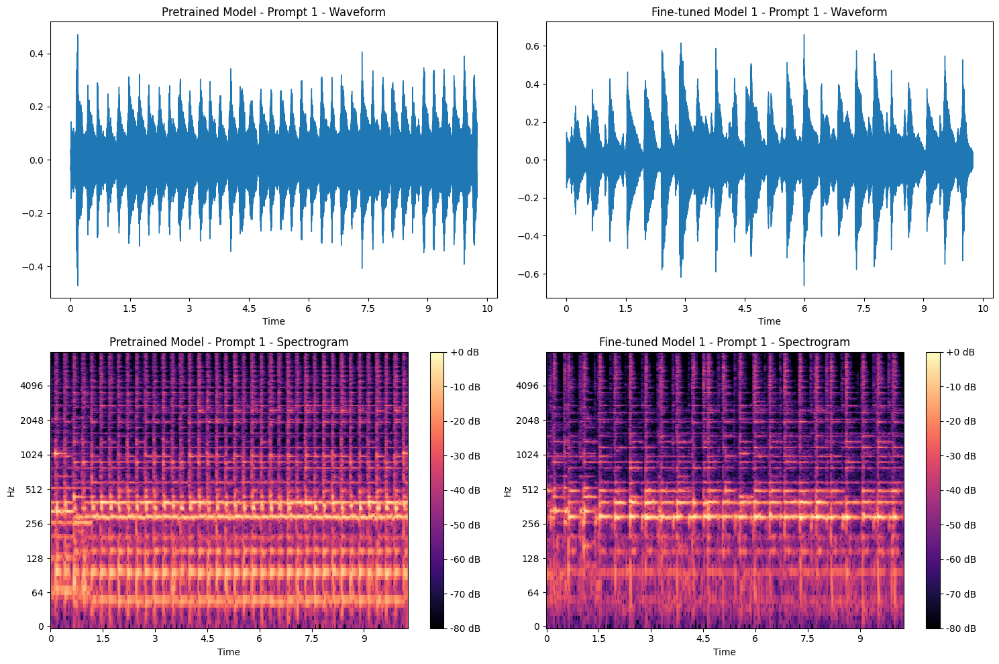

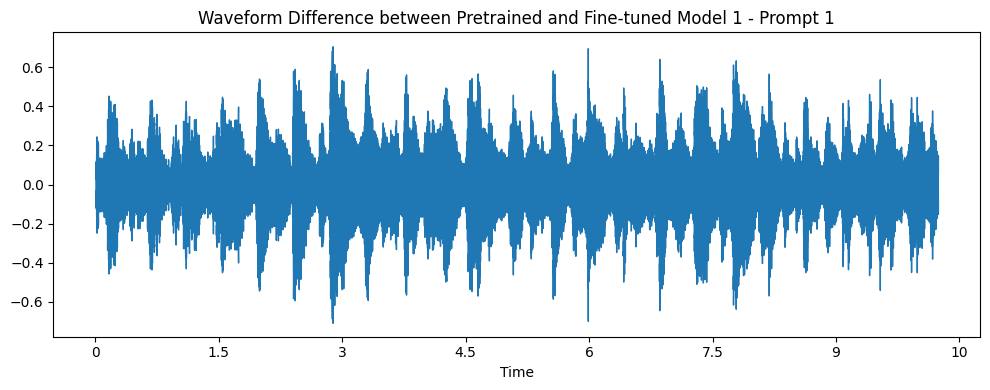

Model 1 - SDR: -19.94 dB, SSNR: -4.85 dB, OVL: 0.62
Playing Fine-tuned Audio (Model 1):


  0%|          | 0/200 [00:00<?, ?it/s]

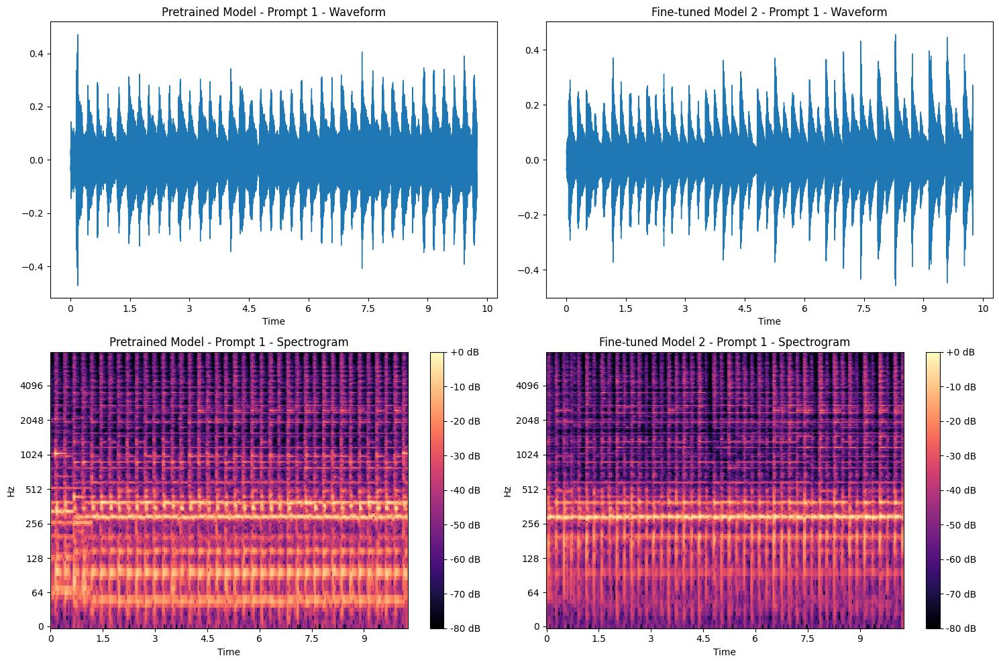

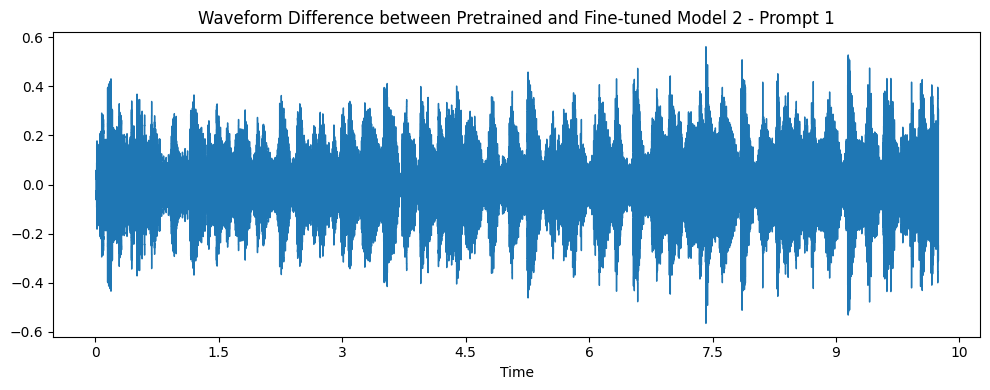

Model 2 - SDR: -18.46 dB, SSNR: -3.38 dB, OVL: 0.61
Playing Fine-tuned Audio (Model 2):


  0%|          | 0/200 [00:00<?, ?it/s]

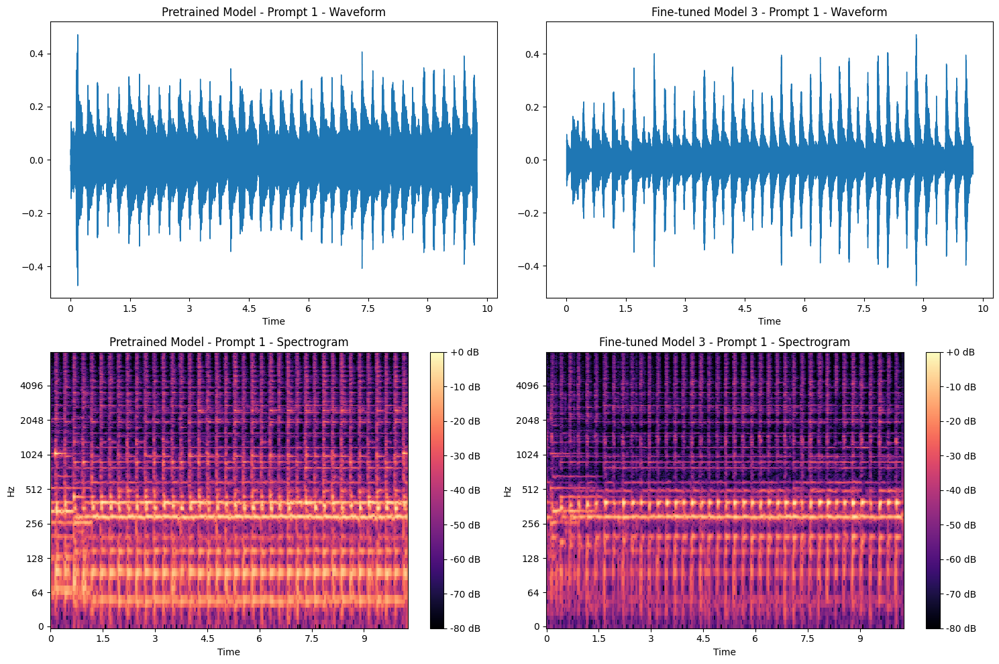

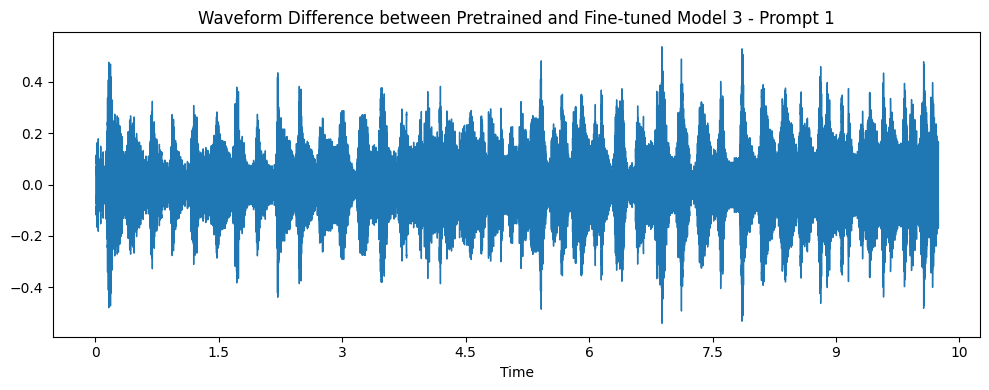

Model 3 - SDR: -19.39 dB, SSNR: -2.47 dB, OVL: 0.50
Playing Fine-tuned Audio (Model 3):


  0%|          | 0/200 [00:00<?, ?it/s]

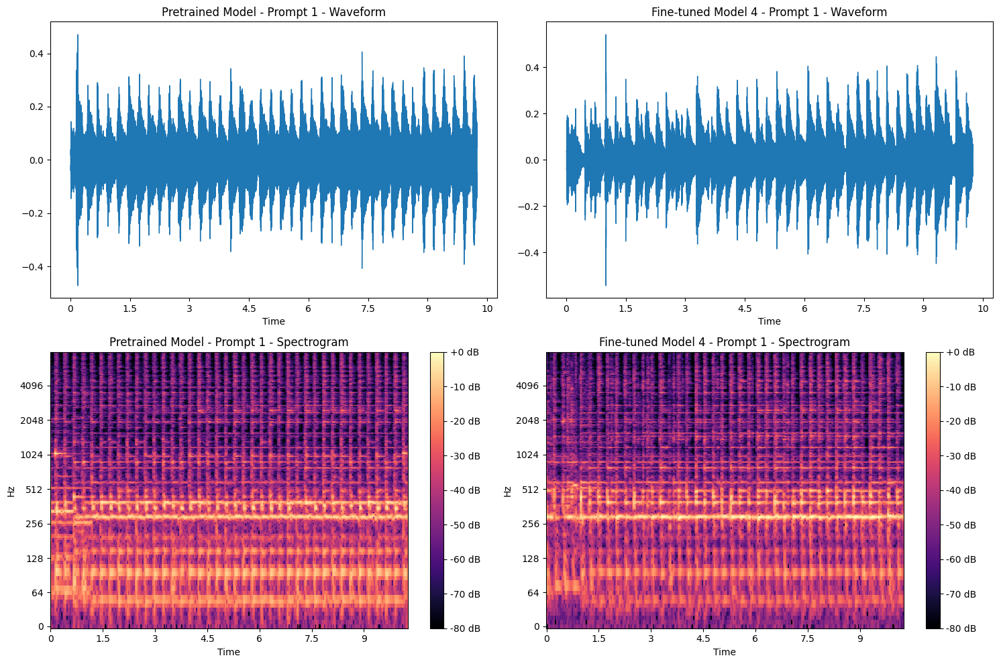

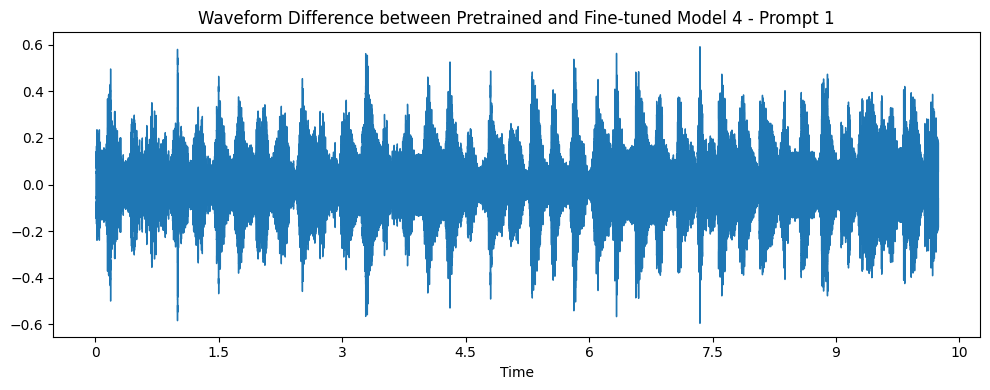

Model 4 - SDR: -16.32 dB, SSNR: -3.00 dB, OVL: 0.61
Playing Fine-tuned Audio (Model 4):


  0%|          | 0/200 [00:00<?, ?it/s]

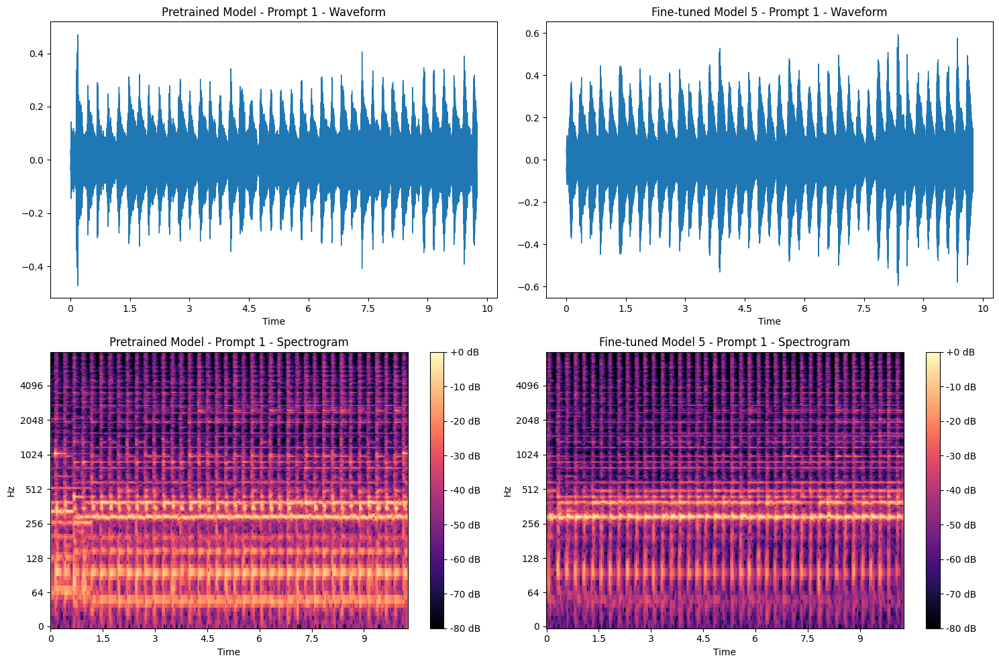

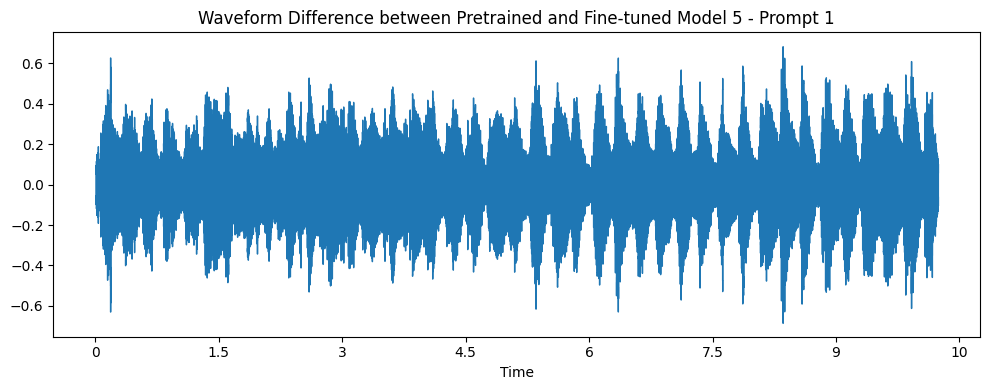

Model 5 - SDR: -18.52 dB, SSNR: -5.63 dB, OVL: 0.69
Playing Fine-tuned Audio (Model 5):


  0%|          | 0/200 [00:00<?, ?it/s]

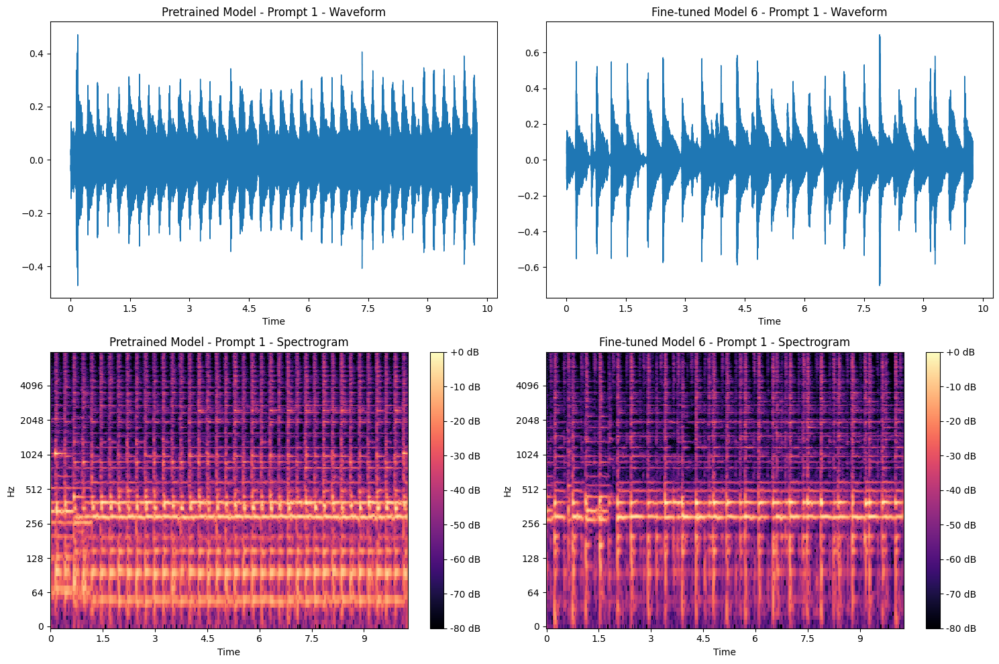

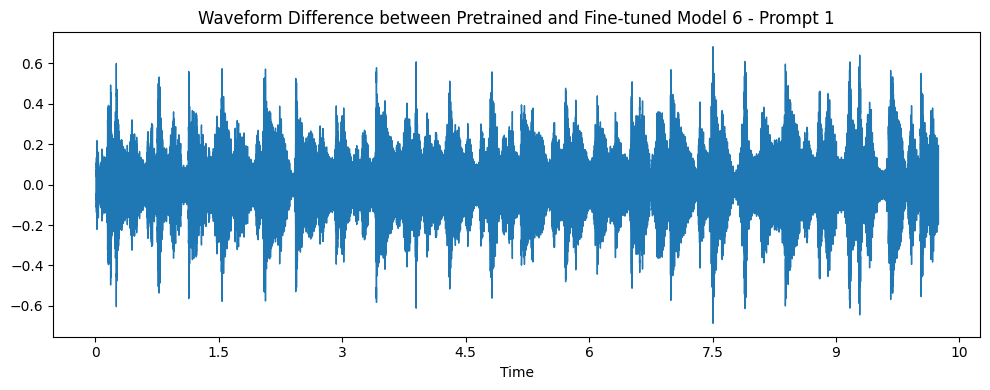

Model 6 - SDR: -19.84 dB, SSNR: -4.00 dB, OVL: 0.60
Playing Fine-tuned Audio (Model 6):


In [ ]:
# Function to generate and compare audio without fixing the seed
def generate_and_compare_without_seed(text_prompts, original_pipe, fine_tuned_models):
    for i, prompt in enumerate(text_prompts):
        print(f"\nComparing audio for prompt: '{prompt}'")

        # Generate audio from pretrained model
        original_audio = original_pipe(prompt=prompt).audios[0]

        # Play original audio
        print("Playing Pretrained Audio:")
        display(Audio(original_audio, rate=16000))

        for j, finetuned_model in enumerate(fine_tuned_models):
            fine_tuned_audio = finetuned_model.pipe(prompt=prompt).audios[0]

            # SDR and SSNR calculations
            sdr_value = calculate_sdr(original_audio, fine_tuned_audio)
            ssnr_value = segmental_snr(original_audio, fine_tuned_audio)
            ovl_value = compute_ovl(original_audio, fine_tuned_audio, sr=16000)

            # Plot comparison of waveforms and spectrograms
            plot_comparison_waveform_spectrogram(
                original_audio, fine_tuned_audio,
                f"Pretrained Model - Prompt {i+1}",
                f"Fine-tuned Model {j+1} - Prompt {i+1}"
            )

            # Plot waveform difference
            plot_waveform_difference(
                original_audio, fine_tuned_audio,
                f"Waveform Difference between Pretrained and Fine-tuned Model {j+1} - Prompt {i+1}"
            )

            # Print SDR and SSNR values
            print(f"Model {j+1} - SDR: {sdr_value:.2f} dB, SSNR: {ssnr_value:.2f} dB, OVL: {ovl_value:.2f}")

            # Play fine-tuned audio
            print(f"Playing Fine-tuned Audio (Model {j+1}):")
            display(Audio(fine_tuned_audio, rate=16000))

# Run comparison without fixing the seed
generate_and_compare_without_seed(text_prompts, original_pipe, fine_tuned_models)




Comparing audio for prompt: ' A classical drum with guitar background'


  0%|          | 0/200 [00:00<?, ?it/s]

Playing Pretrained Audio:


  0%|          | 0/200 [00:00<?, ?it/s]

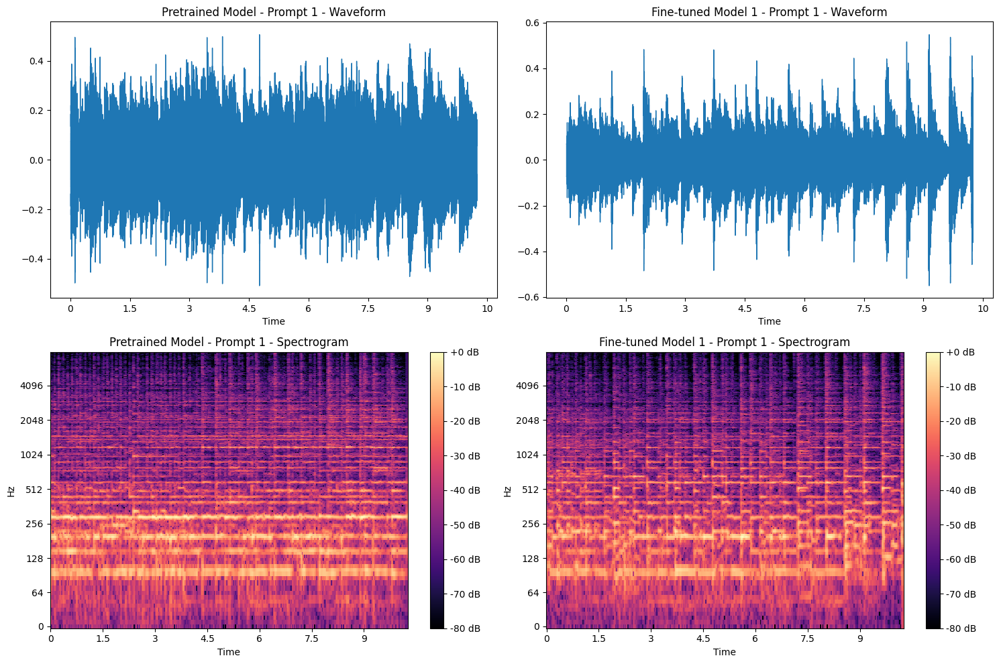

Model 1 - SDR: -21.70 dB, SSNR: -1.53 dB
Playing Fine-tuned Audio (Model 1):


  0%|          | 0/200 [00:00<?, ?it/s]

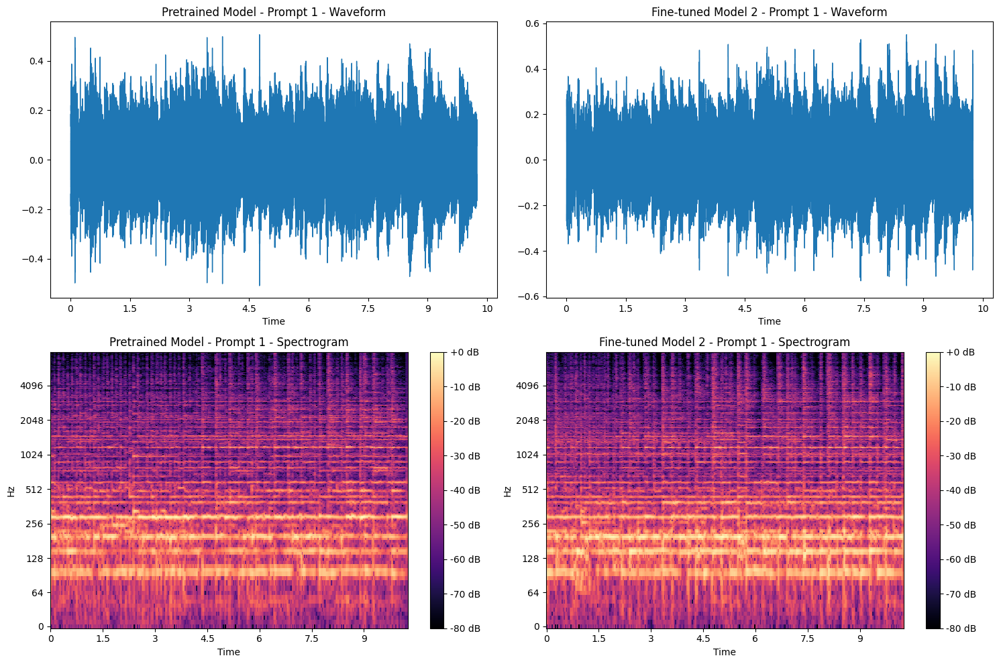

Model 2 - SDR: -17.34 dB, SSNR: -2.95 dB
Playing Fine-tuned Audio (Model 2):


  0%|          | 0/200 [00:00<?, ?it/s]

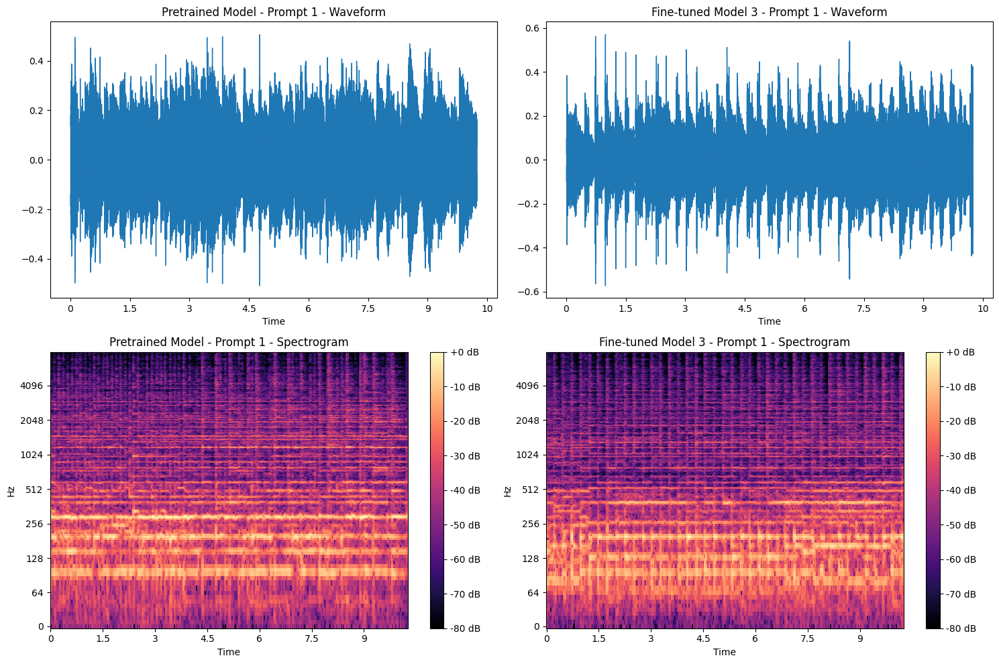

Model 3 - SDR: -18.33 dB, SSNR: -2.50 dB
Playing Fine-tuned Audio (Model 3):


  0%|          | 0/200 [00:00<?, ?it/s]

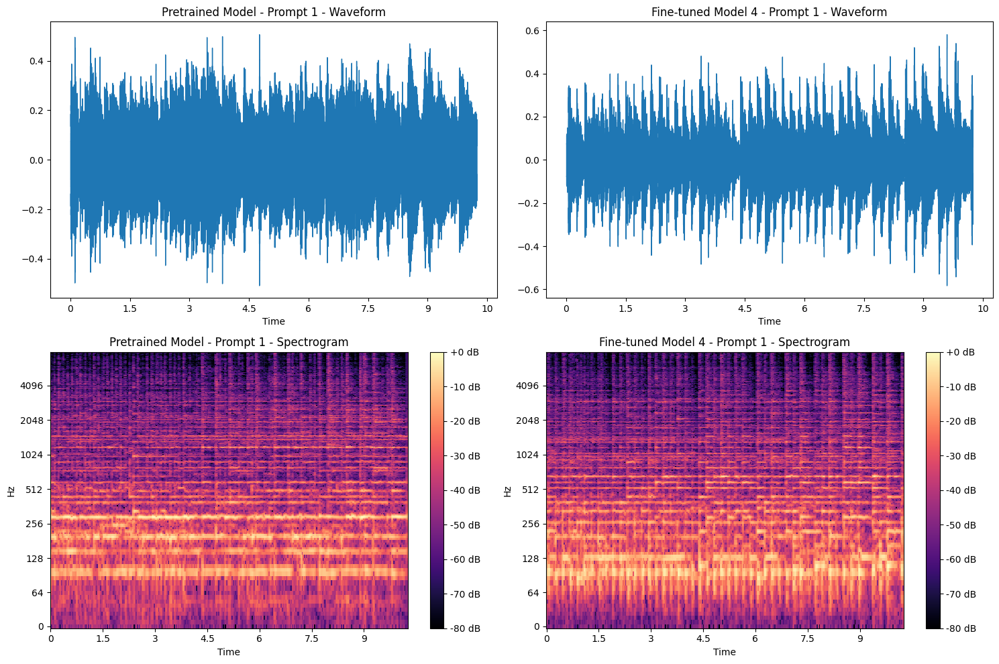

Model 4 - SDR: -19.53 dB, SSNR: -2.23 dB
Playing Fine-tuned Audio (Model 4):


  0%|          | 0/200 [00:00<?, ?it/s]

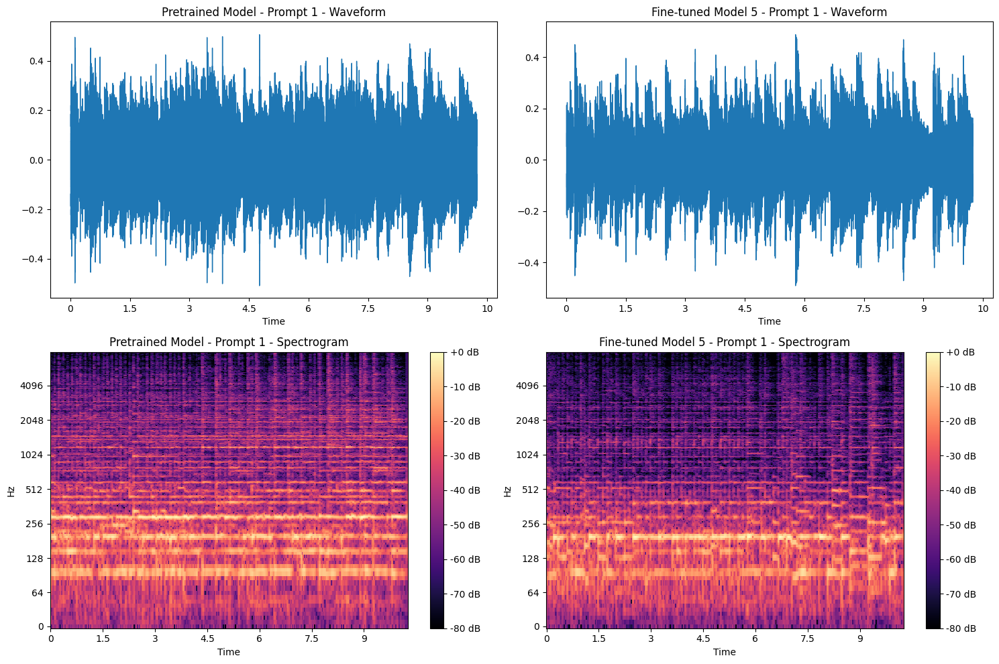

Model 5 - SDR: -15.87 dB, SSNR: -3.29 dB
Playing Fine-tuned Audio (Model 5):


  0%|          | 0/200 [00:00<?, ?it/s]

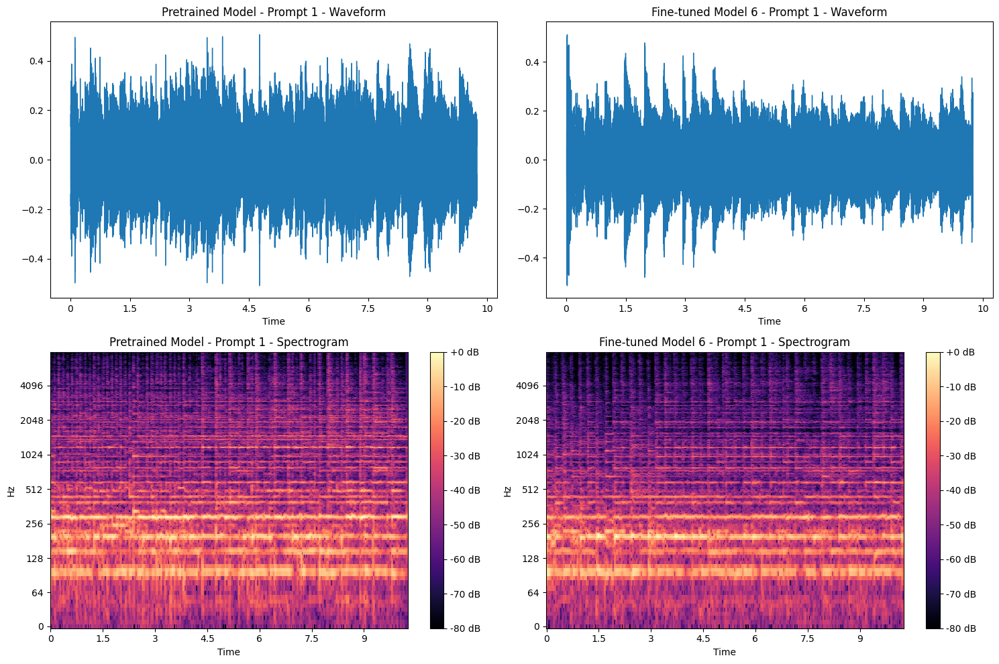

Model 6 - SDR: -17.08 dB, SSNR: -2.09 dB
Playing Fine-tuned Audio (Model 6):


In [ ]:
# Example text prompt
text_prompts = [
    " A classical drum with guitar background"
]

# Run comparison
generate_and_compare(text_prompts, original_pipe, fine_tuned_models)